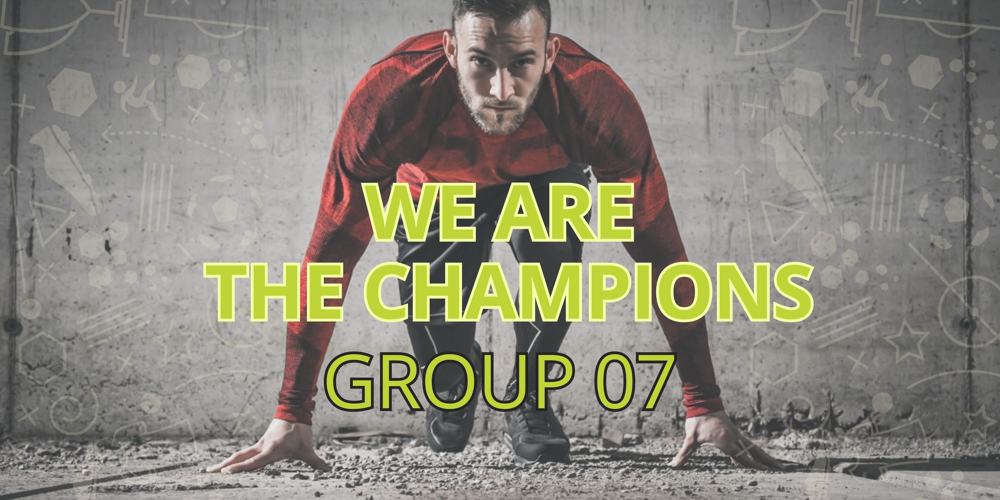

# <font color='#BFD72F'>**Contents**</font> <a class="anchor" id="toc"></a>

* [Initial Configurations](#initialconfigurations)
    * [1 - Connect to Google Colab](#colab)
    * [2 - Importing Libraries and Data](#import)
* [1 - Data Understanding](#dataunderstanding)
    * [1 - Initial Check of Data](#1checkofdata)
    * [2 - Understanding the Data](#understandingthedata)
    * [3 -  Data Visualization](#datavisualization)
* [2 - Data Preprocessing](#datapreprocessing)
    * [1 -  Handling Incoherences](#handlingincoherences)
<br>

# <font color='#BFD72F'> **Initial Configurations**</font> <a class="anchor" id="colab"></a>
[Back to Contents](#toc)

In [ ]:
# Connect Google Colab to Drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
path = '/content/drive/MyDrive/Colab Notebooks/PMDM/Projeto/'

Mounted at /content/drive


In [ ]:
# Import libraries
! pip install category_encoders
from category_encoders import TargetEncoder
import pandas as pd     #Import pandas library  
import seaborn as sns   #Import seaborn (graphical package) to have provide a high-level interface to Matplotlib
import matplotlib.pyplot as plt    #Import matplotlib.pyplot to create plots and use the command '%matplotlib inline' after importing the library matplotlib as a way to guarantee that the plots will be included in the notebook, next to the code
%matplotlib inline
from sklearn.cluster import DBSCAN
from sklearn.impute import KNNImputer
import numpy as np
import scipy.stats as stats
from math import ceil
from scipy.stats import chi2_contingency
from sklearn.preprocessing import KBinsDiscretizer, MinMaxScaler, StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression, ElasticNetCV
from sklearn.feature_selection import RFE, f_classif, SelectKBest, chi2
from sklearn.neighbors import KNeighborsClassifier, LocalOutlierFactor
from sklearn.ensemble import IsolationForest, VotingClassifier, GradientBoostingClassifier, BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, accuracy_score, precision_score, recall_score, f1_score

**Step 2** - Read the excel file datasource 'WAC_train.csv' that is inside of the folder 'project'. Save it to the object data using the pandas method pd.read_excel().

In [ ]:
# Import data
data = pd.read_csv(path + 'WAC_train.csv')
test = pd.read_csv(path + 'test.csv')

# <font color='#BFD72F'>**1. DATA UNDERSTANDING**</font> <a class="anchor" id="import"></a>

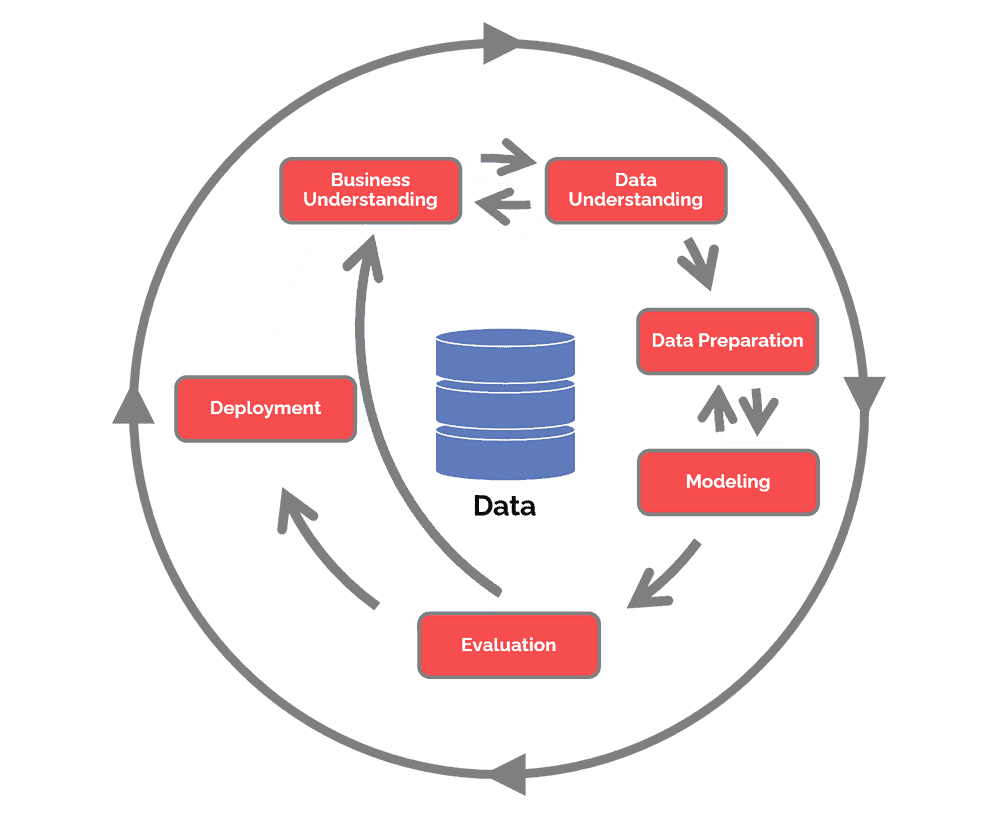

## <font color='#BFD72F'>Metadata</font> <a class="anchor" id="import"></a>
 
 This dataset contains 18055 competition registrations (rows) that encompass 30 features describing the competition and the athletes characteristics in the moment of each competition (columns).
The target is a categorical variable so this is a classication problem.
<br><br>

**Identifiers**:
- `Athlete id` - ID
- `RecordID` - ID of the registration of one athlete into an edition of a given competition


**Competitions Data**:
- `Competition` - Type of competition
- `Edition` - The year of the edition competition
- `Athlete score` - Athlete score from previous competitions
- `Cancelled enrollment` - Athlete cancelled the competition enrollment
- `Late enrollment` - Athlete enrolled in the competition belatedly 
- `Previous attempts` - Number of previous competitions attempts


**Sociodemographic Data**:
- `Age group` - Athlete age range
- `Education` - Athlete education level
- `Income` - Athlete income level
- `Sex` - Athlete sex
- `Region` - Athlete region
- `Disability` - Athlete with disability


**Medical Conditions Data**:
- `Past injuries` - Athlete had sport injuries
- `Physiotherapy` - Number of physiotherapy sessions


**Training Data**
- `Mental preparation` - Athlete has developed strategies for handling with stress and pressure
- `No coach` - Athlete does not have a coach
- `Other training` - Number of training sessions using non-standard approaches
- `Outdoor workout` - Training conducted outdoors in parks or forests
- `Sand training` - Number of training sessions involving sand drills
- `Sport-specific training` - Number of training sessions that mimic competition scenarios
- `Squad training` - Number of training sessions that involve a group of athletes working together to prepare for competition
- `Strength training` - Number of training sessions using weightlifting and bodyweight exercises
- `Supplements` - Number of nutritional supplements taken to aid performance
- `Cardiovascular training` - Number of training sessions such as running, cycling, or swimming
- `Plyometric training` - Number of training sessions involving explosive, high-intensity movements
- `Train bf competition` - Number of pre-competition preparation sessions
- `Recovery` - Number of recovery sessions using stretching and massages techniques
<br><br>


**Target**:
- `Outcome` - Competition result.

In [ ]:
data.info()

In [ ]:
test.info()

## <font color='#BFD72F'>Target variable</font> <a class="anchor" id="import"></a>

- Verify if the target variable is a discrete variable or a continuous variable, to understand what kind of problem we are dealing with
- Validate if the dependent variable `Outcome` is balanced by using the method `sns.countplot`. 

In [ ]:
data['Outcome'].isna().sum()

In [ ]:
data['Outcome'].value_counts()/len(data)

In [ ]:
sns.countplot(x = 'Outcome', data = data, palette=['yellowgreen', 'lightgrey'])

**Conclusion**

 - It is a classification problem
 - The target variable does not have missing values
 - Is not an imbalance dataset

## <font color='#BFD72F'>Describing the features</font> <a class="anchor" id="import"></a>

In [ ]:
data.head()

In [ ]:
print(data.shape)
print(test.shape)

**Conclusion**

---There are 18055 rows and 30 columns in these dataset---

In [ ]:
# To verify duplicated rows
duplicated_rows_data = data.duplicated()
num_duplicated_rows_data = duplicated_rows_data.sum()
duplicated_rows_test = test.duplicated()
num_duplicated_rows_test = duplicated_rows_test.sum()

# Print number of duplicated rows
print("Number of duplicated lines in train: ", num_duplicated_rows_data)
print("Number of duplicated lines in test: ", num_duplicated_rows_test)

**Conclusion**

---There are not duplicated values in these datasets---

In [ ]:
total_recordid_data =  data['RecordID'].nunique()

print("Total record ID in train: ",total_recordid_data)

total_recordid_test =  test['RecordID'].nunique()

print("Total record ID in test: ",total_recordid_test)

**Conclusion**

---There are not duplicated record ID, nor missing values in the index of these datasets---

In [ ]:
total_athletes_data =  data['Athlete Id'].nunique()

print("Total of athletes train: ",total_athletes_data)

total_athletes_test =  test['Athlete Id'].nunique()

print("Total of athletes test: ",total_athletes_test)

**Conclusion**

---There are athletes that appear more then once in these datasets---

In [ ]:
#Create a dataset with features to analyse the descriptive statistics:#
df = data.drop(['RecordID', 'Outcome'], axis=1)

In [ ]:
#Create a dataset with features to analyse the descriptive statistics:#
df_teste = test.drop(['RecordID'], axis=1)

In [ ]:
## Analysing numeric variables#
df.describe().T

In [ ]:
df_teste.describe().T

**Conclusions**

Athlete Id - shoud be an categorial feature not a numerical feature.

Edition - shoud be an categorial feature not a numerical feature.

In every feature the mean is always higher than the median, which means that the distribution of all features is not symmetrical, is, instead, positively skewed, meaning there are athletes that push the average (mean) upward.This skewness suggests that there are relatively few athletes in the dataset, that have a disproportionate impact on the mean.
The question is, can it be that this impact caused always by the same athletes? or depends on other factors?

We can observe missing values in all features

In [ ]:
##Analysing categorical variables#
df.describe(include = ['O']).T

In [ ]:
##Analysing categorical variables#
df_teste.describe(include = ['O']).T

**Conclusions**

We can observe missing values in all features in the train dataset

In [ ]:
## Print list of variables#
column_names = data.columns.tolist()
print(column_names)

**a) Categorical Variables**

Step 1 - Validate if there are any errors or incoherent values in the column  by applying the method .value_counts().

AND

Step 2 - Treat the incoherences found above by using the method replace() to replace the erros with the most appropriate values.

In [ ]:
data['Competition'].value_counts()/len(data)

Local Match                 0.243921
Regional Tournament         0.234007
Federation League           0.189255
National Cup                0.131432
Continental Championship    0.088452
World Championship          0.080532
Olympic Games               0.027582
Name: Competition, dtype: float64

In [ ]:
contingency_table_competition = pd.crosstab([data['Competition']], data['Outcome'], normalize='index')*100
print(contingency_table_competition)

Outcome                           0          1
Competition                                   
Continental Championship  28.804008  71.195992
Federation League         46.561311  53.438689
Local Match               41.348774  58.651226
National Cup              51.495997  48.504003
Olympic Games             24.899598  75.100402
Regional Tournament       38.650888  61.349112
World Championship        27.854195  72.145805


In [ ]:
test['Competition'].value_counts()/len(test)

Local Match                 0.240372
Regional Tournament         0.234298
Federation League           0.193461
National Cup                0.132334
Continental Championship    0.089041
World Championship          0.083743
Olympic Games               0.026751
Name: Competition, dtype: float64

In [ ]:
contingency_test_competition = pd.crosstab([data['Competition']], data['Outcome'], normalize='index')*100
print(contingency_test_competition)

Outcome                           0          1
Competition                                   
Continental Championship  28.804008  71.195992
Federation League         46.561311  53.438689
Local Match               41.348774  58.651226
National Cup              51.495997  48.504003
Olympic Games             24.899598  75.100402
Regional Tournament       38.650888  61.349112
World Championship        27.854195  72.145805


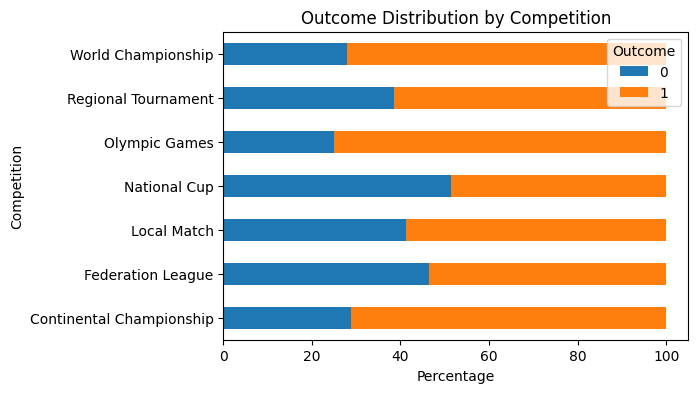

In [ ]:
# Plot the contingency table
contingency_table_competition.plot(kind='barh', stacked=True, figsize=(6, 4))

# Set the labels and title
plt.xlabel('Percentage')
plt.ylabel('Competition')
plt.title('Outcome Distribution by Competition')

# Show the plot
plt.show()


In [ ]:
data['Education'].value_counts()/len(data)

High school          0.446358
Middle school        0.374135
University Degree    0.155469
Post Graduate        0.010246
Elementary school    0.008529
Name: Education, dtype: float64

In [ ]:
test['Education'].value_counts()/len(test)

High school          0.436676
Middle school        0.391316
University Degree    0.150297
Post Graduate        0.012019
Elementary school    0.009692
Name: Education, dtype: float64

In [ ]:
contingency_table_education = pd.crosstab([data['Education']], data['Outcome'], normalize='index')*100
print(contingency_table_education)

Outcome                    0          1
Education                              
Elementary school  53.896104  46.103896
High school        36.605038  63.394962
Middle school      47.727609  52.272391
Post Graduate      25.945946  74.054054
University Degree  33.630210  66.369790


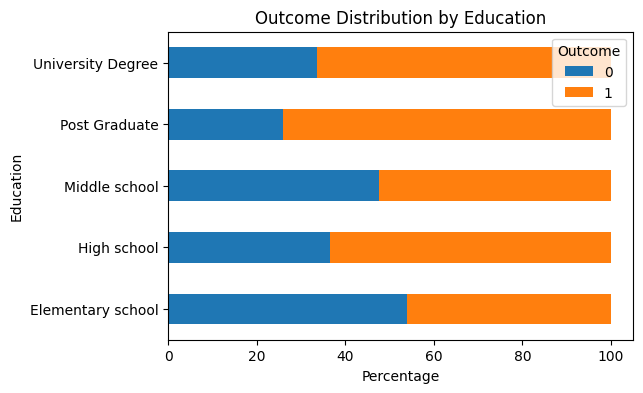

In [ ]:
# Plot the contingency table
contingency_table_education.plot(kind='barh', stacked=True, figsize=(6, 4))

# Set the labels and title
plt.xlabel('Percentage')
plt.ylabel('Education')
plt.title('Outcome Distribution by Education')

# Show the plot
plt.show()

In [ ]:
data['Region'].value_counts()/len(data)

North America      0.110828
Western Europe     0.102742
East Asia          0.097868
South America      0.093547
Northern Africa    0.082803
Eastern Europe     0.076710
Middle East        0.076101
Central Asia       0.070618
Central America    0.066020
Oceania            0.064747
Southern Europe    0.058322
South Asia         0.054999
Southern Africa    0.039047
Name: Region, dtype: float64

In [ ]:
data_contingency_table_region = pd.crosstab([data['Region']], data['Outcome'], normalize='index')*100
print(data_contingency_table_region)

Outcome                  0          1
Region                               
Central America  45.469799  54.530201
Central Asia     40.235294  59.764706
East Asia        36.389360  63.610640
Eastern Europe   41.660650  58.339350
Middle East      36.972344  63.027656
North America    41.079460  58.920540
Northern Africa  46.755853  53.244147
Oceania          36.612489  63.387511
South America    44.464180  55.535820
South Asia       36.455186  63.544814
Southern Africa  37.872340  62.127660
Southern Europe  41.785375  58.214625
Western Europe   37.520216  62.479784


In [ ]:
test['Region'].value_counts()/len(test)

North America      0.105971
Western Europe     0.100930
East Asia          0.095115
South America      0.092918
Northern Africa    0.086456
Middle East        0.074179
Eastern Europe     0.073533
Central Asia       0.070819
Central America    0.069527
Oceania            0.066425
Southern Europe    0.064358
South Asia         0.056733
Southern Africa    0.043034
Name: Region, dtype: float64

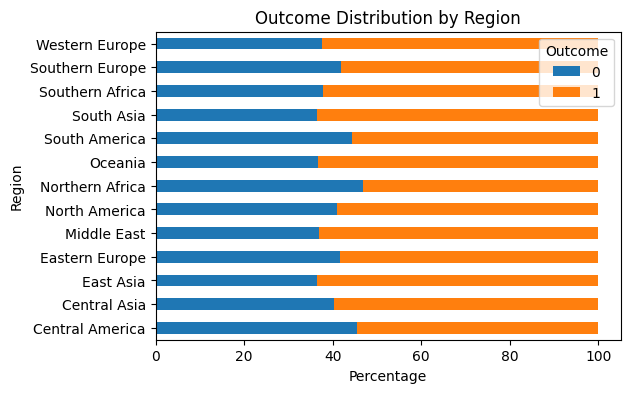

In [ ]:
# Plot the contingency table
data_contingency_table_region.plot(kind='barh', stacked=True, figsize=(6, 4))

# Set the labels and title
plt.xlabel('Percentage')
plt.ylabel('Region')
plt.title('Outcome Distribution by Region')

# Show the plot
plt.show()

In [ ]:
data['Edition'].value_counts()

2022.0    6213
2019.0    4882
2021.0    4153
2020.0    2711
Name: Edition, dtype: int64

In [ ]:
test['Edition'].value_counts()

2022    2677
2019    2174
2021    1807
2020    1080
Name: Edition, dtype: int64

In [ ]:
data['Previous attempts'].value_counts()

0.0    15773
1.0     1742
2.0      356
3.0       73
4.0       14
5.0        7
6.0        3
Name: Previous attempts, dtype: int64

In [ ]:
test['Previous attempts'].value_counts()

0    6782
1     759
2     156
3      25
4      14
5       2
Name: Previous attempts, dtype: int64

In [ ]:
data['Sex'].value_counts()

M    9878
F    8084
Name: Sex, dtype: int64

In [ ]:
test['Sex'].value_counts()

M    4262
F    3476
Name: Sex, dtype: int64

In [ ]:
cont_table_sand_cpt = pd.crosstab([data['Competition']], data['Sand training']==0, normalize='index')*100
print(cont_table_sand_cpt)

Sand training                 False      True 
Competition                                   
Continental Championship   0.626174  99.373826
Federation League         35.645303  64.354697
Local Match               11.058129  88.941871
National Cup               0.632111  99.367889
Olympic Games             23.895582  76.104418
Regional Tournament       36.970414  63.029586
World Championship        51.856946  48.143054


In [ ]:
cont_table_squad_cpt = pd.crosstab([data['Competition']], data['Squad training']==0, normalize='index')*100
print(cont_table_squad_cpt)

Squad training                False      True 
Competition                                   
Continental Championship  59.549155  40.450845
Federation League         58.472344  41.527656
Local Match               49.159855  50.840145
National Cup              35.187526  64.812474
Olympic Games             30.321285  69.678715
Regional Tournament       29.112426  70.887574
World Championship         0.412655  99.587345


In [ ]:
data['Age group'].value_counts()

0-35     12470
35-55     5325
55<=       134
0           23
Name: Age group, dtype: int64

In [ ]:
test['Age group'].value_counts()

0-35     5350
35-55    2337
55<=       51
Name: Age group, dtype: int64

In [ ]:
data['Income'].value_counts()

High           5395
Middle-Low     3844
Middle         3548
Low            3541
Middle-High    1637
Name: Income, dtype: int64

In [ ]:
test['Income'].value_counts()

High           2349
Middle-Low     1656
Middle         1528
Low            1471
Middle-High     734
Name: Income, dtype: int64

In [ ]:
data['Disability'].value_counts()

False    16298
True      1668
Name: Disability, dtype: int64

In [ ]:
test['Disability'].value_counts()

False    7002
True      736
Name: Disability, dtype: int64

In [ ]:
data['Late enrollment'].value_counts()

False    17830
True       139
Name: Late enrollment, dtype: int64

In [ ]:
test['Late enrollment'].value_counts()

False    7675
True       63
Name: Late enrollment, dtype: int64

In [ ]:
data['Mental preparation'].value_counts()

FALSE    16519
TRUE      1360
FASE        99
Name: Mental preparation, dtype: int64

In [ ]:
data['Outdoor Workout'].value_counts()

False    16777
True      1194
Name: Outdoor Workout, dtype: int64

In [ ]:
test['Outdoor Workout'].value_counts()

False    7218
True      520
Name: Outdoor Workout, dtype: int64

In [ ]:
data['No coach'].value_counts()

False    17969
True         2
Name: No coach, dtype: int64

In [ ]:
test['No coach'].value_counts()

False    7737
True        1
Name: No coach, dtype: int64

In [ ]:
data['Past injuries'].value_counts()

True     9872
False    8078
Name: Past injuries, dtype: int64

In [ ]:
test['Past injuries'].value_counts()

True     4201
False    3537
Name: Past injuries, dtype: int64

**b) Numeric Variables**

Step 3 - Check if there are any values that don't make sense in the numeric variables

AND 

Step 4 - Treat the possible errors found above. Instead of just replacing the error with a missing value, replace it with the mean of the column (you can calculate the mean of a column by using the method .mean()).

In [ ]:
data['Athlete score'].value_counts()/len(data)*100

 0.0      53.215176
 60.0     17.939629
-30.0     12.107449
 30.0      9.343672
 90.0      2.082526
 120.0     2.038217
 140.0     1.257269
 10.0      0.371088
 15.0      0.282470
 70.0      0.121850
-15.0      0.105234
 20.0      0.105234
 40.0      0.094157
 75.0      0.088618
-20.0      0.060925
 50.0      0.044309
 100.0     0.038770
 45.0      0.038770
 105.0     0.033232
 55.0      0.022155
-10.0      0.022155
 110.0     0.022155
 80.0      0.022155
 25.0      0.016616
 85.0      0.016616
 35.0      0.011077
-5.0       0.011077
 5.0       0.005539
Name: Athlete score, dtype: float64

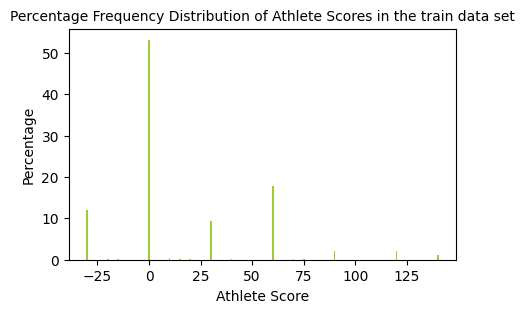

In [ ]:
percentage_distribution = data['Athlete score'].value_counts() / len(data) * 100

# Set the figure size
plt.figure(figsize=(5, 3))

# Plot the bar graph
plt.bar(percentage_distribution.index, percentage_distribution, color='yellowgreen')

# Set the labels and title
plt.xlabel('Athlete Score')
plt.ylabel('Percentage')
plt.title('Percentage Frequency Distribution of Athlete Scores in the train data set', fontsize=10)

# Show the plot
plt.show()


In [ ]:
test['Athlete score'].value_counts()/len(test)*100

 0.0      53.773585
 60.0     17.032825
-30.0     12.626002
 30.0      9.757043
 90.0      2.209873
 120.0     2.003102
 140.0     1.124322
 15.0      0.439390
 10.0      0.232618
-15.0      0.129232
 75.0      0.116309
-20.0      0.116309
 70.0      0.077539
 40.0      0.064616
 20.0      0.064616
 100.0     0.051693
 50.0      0.038770
 85.0      0.038770
 105.0     0.025846
 45.0      0.025846
 110.0     0.012923
 95.0      0.012923
 35.0      0.012923
-10.0      0.012923
Name: Athlete score, dtype: float64

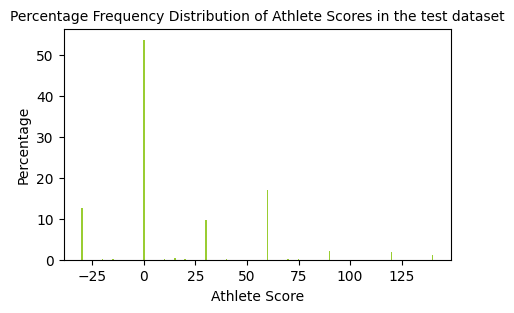

In [ ]:
percentage_distribution_test = test['Athlete score'].value_counts() / len(test) * 100

# Set the figure size
plt.figure(figsize=(5, 3))

# Plot the bar graph using the percentage_distribution_test
plt.bar(percentage_distribution_test.index, percentage_distribution_test, color='yellowgreen')

# Set the labels and title
plt.xlabel('Athlete Score')
plt.ylabel('Percentage')
plt.title('Percentage Frequency Distribution of Athlete Scores in the test dataset', fontsize=10)

# Show the plot
plt.show()



**Conclusion**

The behaviour of this features is dificult to understand.
- the distribution is very similar between the dataset and the test dataset
- there are negative values
- more than 50% of the records have a score equal to zero

**Conclusions**

Physiotherapy - has a negative value in the train dataset that seems that should be corrected

## <font color='#BFD72F'>Data Visualization</font> <a class="anchor" id="import"></a>

In [ ]:
numeric_metrics = ['Previous attempts', 'Athlete score',  'Train bf competition', 'Strength training', 'Sand training', 'Recovery', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Plyometric training', 'Sport-specific training', 'Other training']

In [ ]:
non_numeric_metrics = ['Competition','Edition','Sex','Region', 'Education', 'Age group','Income','Disability','Mental preparation','Outdoor Workout','Past injuries','Cancelled enrollment']

**Categorical variables**

<Axes: xlabel='count', ylabel='Late enrollment'>

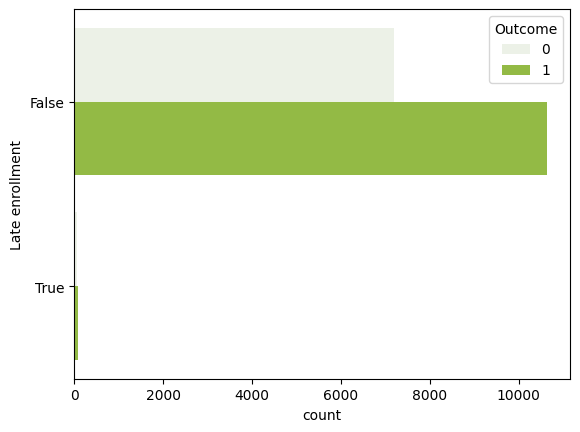

In [ ]:
sns.countplot(y = 'Late enrollment', hue = 'Outcome', data = data, color='yellowgreen')

<Axes: xlabel='count', ylabel='No coach'>

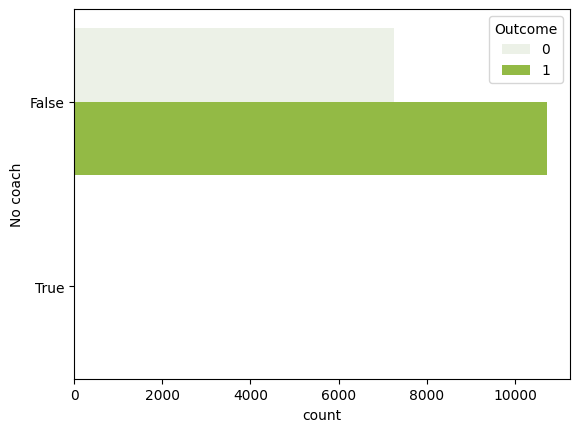

In [ ]:
sns.countplot(y = 'No coach', hue = 'Outcome', data = data, color='yellowgreen')

**Conclusions**

Variables "Late enrollment" and "No coach" do not have discriminate power. Should not be considered.

<Axes: xlabel='count', ylabel='Education'>

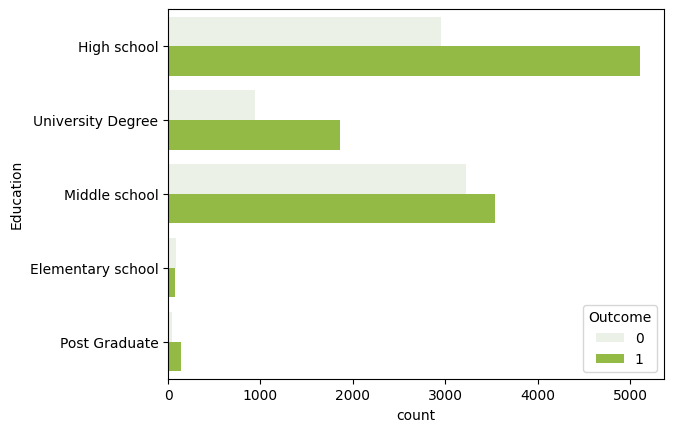

In [ ]:
sns.countplot(y = 'Education', hue = 'Outcome', data = data, color='yellowgreen')

<Axes: xlabel='count', ylabel='Income'>

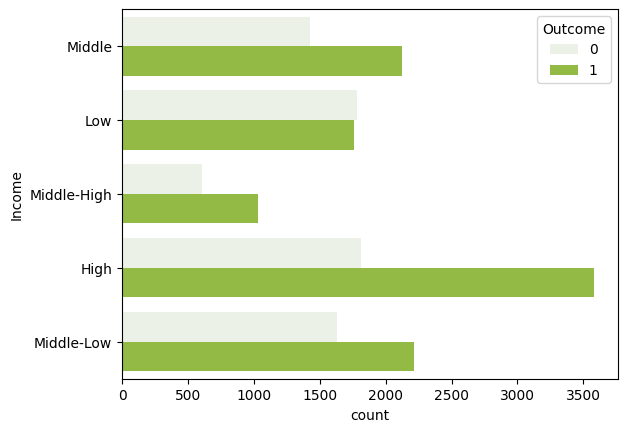

In [ ]:
sns.countplot(y = 'Income', hue = 'Outcome', data = data, color='yellowgreen')

<Axes: xlabel='count', ylabel='Disability'>

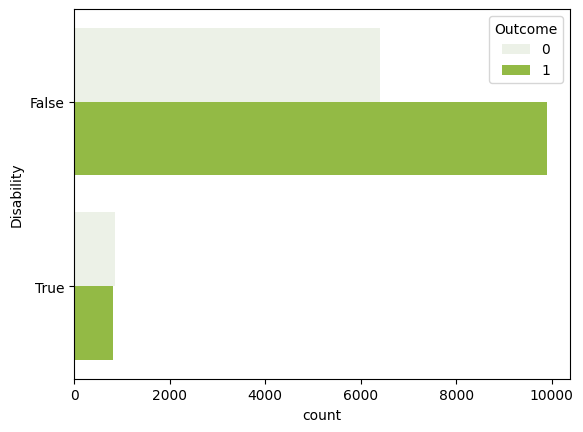

In [ ]:
sns.countplot(y = 'Disability', hue = 'Outcome', data = data, color='yellowgreen')

<Axes: xlabel='count', ylabel='Cancelled enrollment'>

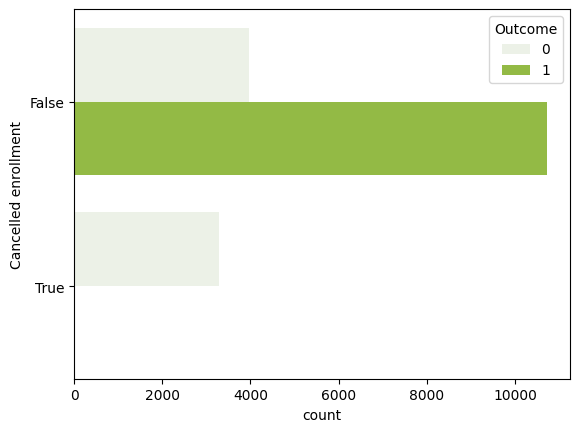

In [ ]:
sns.countplot(y = 'Cancelled enrollment', hue = 'Outcome', data = data, color='yellowgreen')

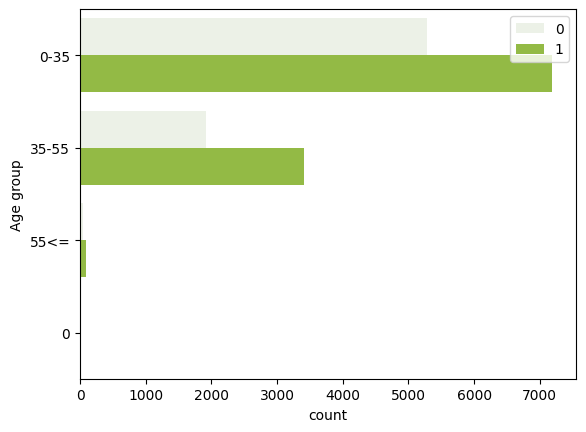

In [ ]:
sns.countplot(y = 'Age group', hue = 'Outcome', data = data, color='yellowgreen')
plt.legend(loc='upper right')
plt.show()

<Axes: xlabel='count', ylabel='Mental preparation'>

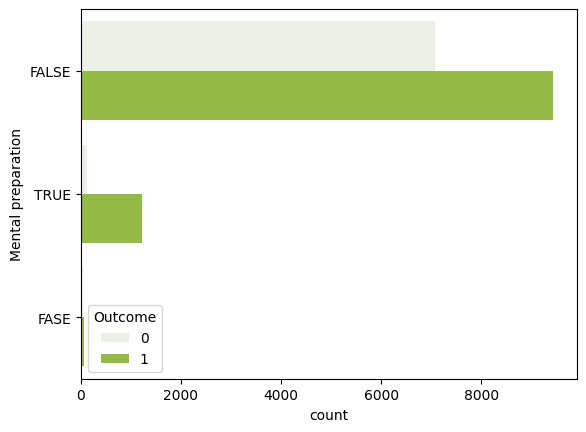

In [ ]:
sns.countplot(y = 'Mental preparation', hue = 'Outcome', data = data, color='yellowgreen')

<Axes: xlabel='count', ylabel='Previous attempts'>

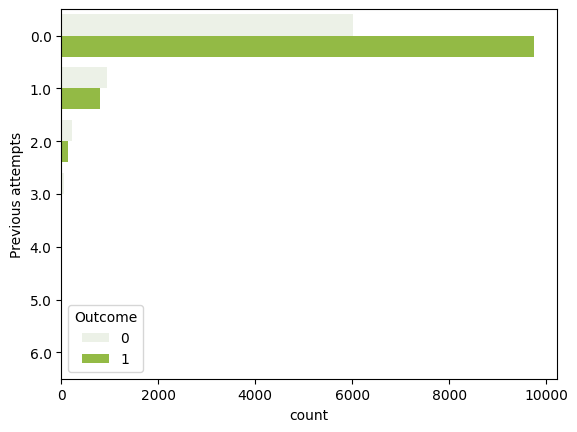

In [ ]:
sns.countplot(y = 'Previous attempts', hue = 'Outcome', data = data, color='yellowgreen')

**Conclusions**

Education, income, disability, cancelled enrollment, and mental preparation appear to have discriminatory power

**Numeric variables**

<Axes: xlabel='Outcome', ylabel='Athlete score'>

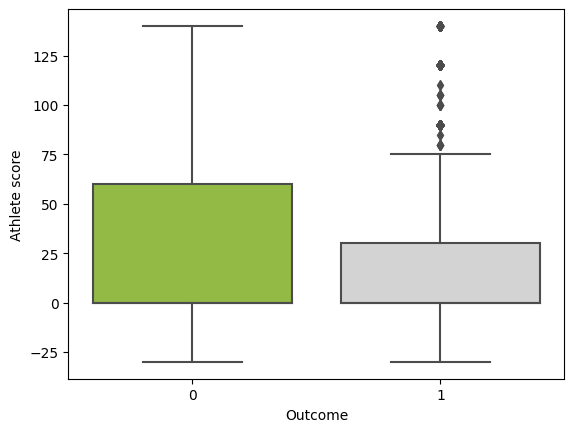

In [ ]:
sns.boxplot (x='Outcome', y='Athlete score', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='count', ylabel='Athlete score'>

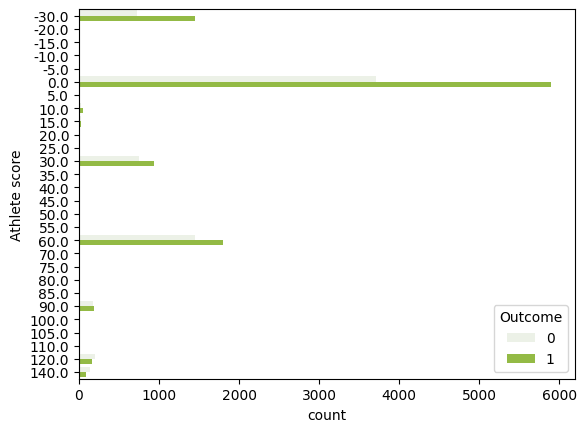

In [ ]:
sns.countplot(y = 'Athlete score', hue = 'Outcome', data = data, color='yellowgreen')

In [ ]:
contingency_table = pd.crosstab([data['Athlete score']], data['Outcome'])

In [ ]:
print(contingency_table)

Outcome           0     1
Athlete score            
-30.0           731  1455
-20.0             2     9
-15.0             5    14
-10.0             1     3
-5.0              1     1
 0.0           3709  5899
 5.0              0     1
 10.0            22    45
 15.0            20    31
 20.0             8    11
 25.0             1     2
 30.0           753   934
 35.0             1     1
 40.0             5    12
 45.0             5     2
 50.0             3     5
 55.0             2     2
 60.0          1444  1795
 70.0             5    17
 75.0            10     6
 80.0             0     4
 85.0             2     1
 90.0           182   194
 100.0            3     4
 105.0            2     4
 110.0            3     1
 120.0          203   165
 140.0          136    91


In [ ]:
filter = (data['Previous attempts']>0)

In [ ]:
df = data[filter]

In [ ]:
df.shape

(2195, 30)

**Conclusions**

Difficult to understand why the average Athlete score is lower in the records indicating a victory, and there are so many outliers present among these last records.
The feature "Athlete score" seems to have a negative correlation with the Target variable. The same seems to happen with the variable "Previous attempts".

<Axes: xlabel='Outcome', ylabel='Train bf competition'>

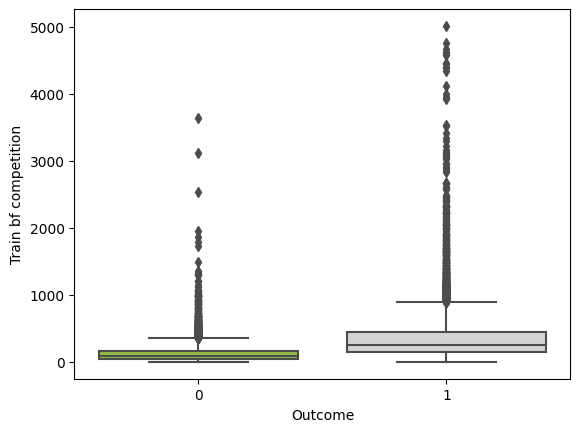

In [ ]:
sns.boxplot (x='Outcome', y='Train bf competition', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Outcome', ylabel='Strength training'>

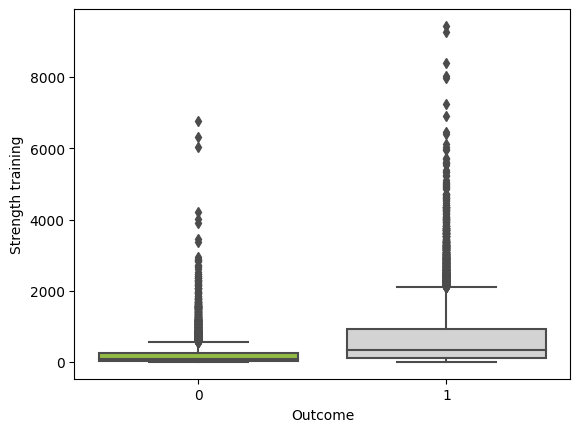

In [ ]:
sns.boxplot (x='Outcome', y='Strength training', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Outcome', ylabel='Recovery'>

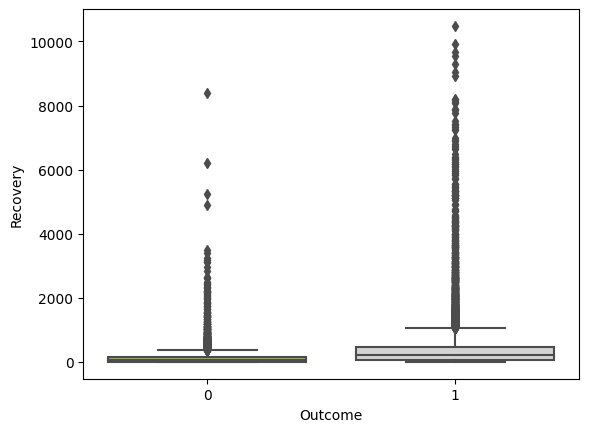

In [ ]:
sns.boxplot (x='Outcome', y='Recovery', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Outcome', ylabel='Supplements'>

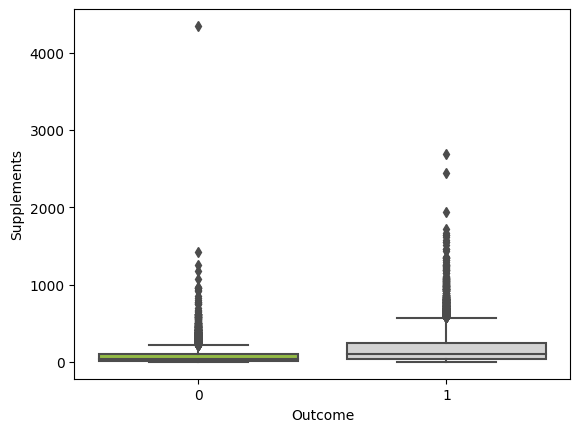

In [ ]:
sns.boxplot (x='Outcome', y='Supplements', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Outcome', ylabel='Cardiovascular training'>

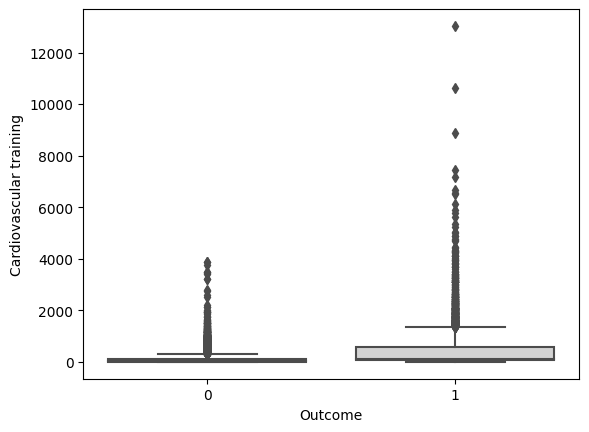

In [ ]:
sns.boxplot (x='Outcome', y='Cardiovascular training', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Outcome', ylabel='Sport-specific training'>

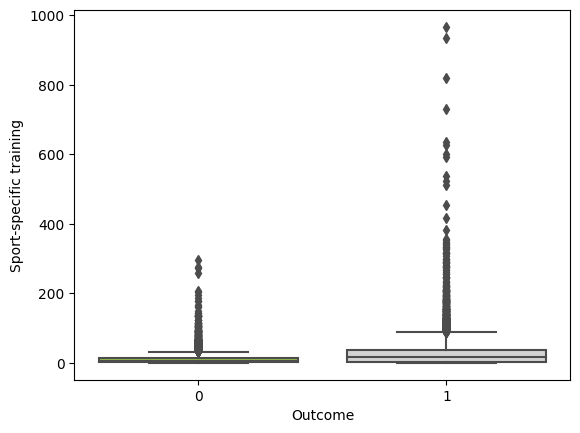

In [ ]:
sns.boxplot (x='Outcome', y='Sport-specific training', data =data, palette=["yellowgreen", "lightgrey"])

(0.0, 1000.0)

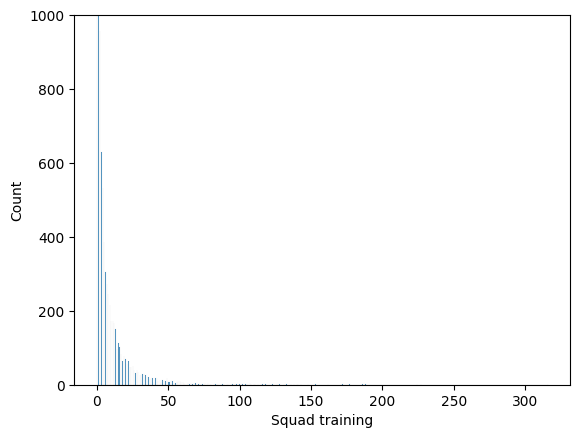

In [ ]:
sns.histplot (x='Squad training', data =data)
plt.ylim(0,1000)

In [ ]:
# Calculate skewness
skewness = stats.skew(data[numeric_metrics] , nan_policy='omit')
print("Skewness:", skewness)

# Calculate kurtosis
kurtosis = stats.kurtosis(data[numeric_metrics], nan_policy='omit')
print("Kurtosis:", kurtosis)

Skewness: [ 3.90989554  1.18277514  4.54296359  3.12443106 35.49530994  6.34869038
  3.5194639   5.55862894  7.06372055  5.62444641  3.84468346  7.12366117
  5.80251991]
Kurtosis: [2.09053296e+01 1.20652992e+00 3.71698755e+01 1.54991125e+01
 1.73796866e+03 5.89905831e+01 3.25059457e+01 6.72244536e+01
 8.66881424e+01 5.02361899e+01 1.60165229e+01 1.10929893e+02
 4.96740718e+01]


In [ ]:
# Calculate Kurtosis for each feature
kurtosis = {feature: stats.kurtosis(values, nan_policy='omit') for feature, values in data[numeric_metrics].items()}

# Create a DataFrame to store the results
df = pd.DataFrame({'Feature': list(kurtosis.keys()), 'kurtosis': list(kurtosis.values())})

# Print the table
print(df)

                    Feature     kurtosis
0         Previous attempts    20.905330
1             Athlete score     1.206530
2      Train bf competition    37.169875
3         Strength training    15.499113
4             Sand training  1737.968663
5                  Recovery    58.990583
6               Supplements    32.505946
7   Cardiovascular training    67.224454
8            Squad training    86.688142
9             Physiotherapy    50.236190
10      Plyometric training    16.016523
11  Sport-specific training   110.929893
12           Other training    49.674072


In [ ]:
# Calculate skewness for each feature
skewness = {feature: stats.skew(values, nan_policy='omit') for feature, values in data[numeric_metrics].items()}

# Create a DataFrame to store the results
df = pd.DataFrame({'Feature': list(skewness.keys()), 'Skewness': list(skewness.values())})

# Print the table
print(df)

                    Feature   Skewness
0         Previous attempts   3.909896
1             Athlete score   1.182775
2      Train bf competition   4.542964
3         Strength training   3.124431
4             Sand training  35.495310
5                  Recovery   6.348690
6               Supplements   3.519464
7   Cardiovascular training   5.558629
8            Squad training   7.063721
9             Physiotherapy   5.624446
10      Plyometric training   3.844683
11  Sport-specific training   7.123661
12           Other training   5.802520


In [ ]:
squad_data=data[(data['Squad training']>3)]

In [ ]:
squad_data.describe().T

,count,mean,std,min,25%,50%,75%,max
RecordID,4216.0,55707.414137,25985.299157,10001.0,33226.5,56113.5,77820.00,99961.0
Edition,4193.0,2020.936799,1.282428,2019.0,2019.0,2022.0,2022.00,2022.0
Athlete Id,4196.0,726055.793851,535748.324121,8462.0,544252.0,604970.0,654421.25,2698588.0
Previous attempts,4199.0,0.127888,0.422205,0.0,0.0,0.0,0.00,5.0
Athlete score,4194.0,17.207916,31.497162,-30.0,0.0,0.0,30.00,140.0
Train bf competition,4197.0,424.566595,416.723447,8.0,190.0,315.0,516.00,5012.0
Strength training,4199.0,772.574661,889.370786,0.0,182.0,411.0,1066.50,9277.0
Sand training,4203.0,8.171782,64.967549,0.0,0.0,0.0,1.00,2480.0
Recovery,4197.0,486.648320,757.236644,0.0,117.0,272.0,556.00,9919.0
Supplements,4194.0,228.119933,224.713311,0.0,69.0,169.0,323.75,4345.0


<ipython-input-91-9a3122ad8230>:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot (x='Sand training', data =data, palette=["yellowgreen", "lightgrey"])


<Axes: xlabel='Sand training', ylabel='Count'>

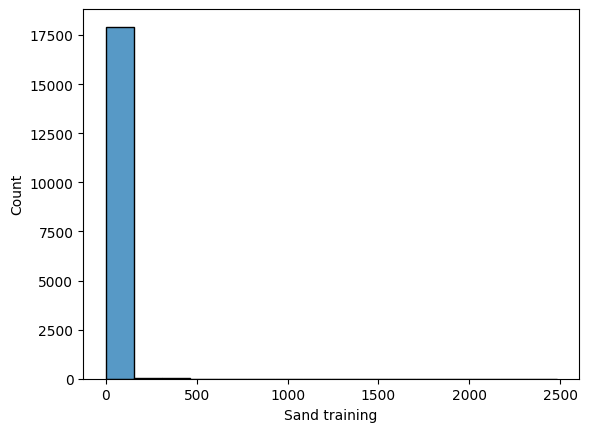

In [ ]:
sns.histplot (x='Sand training', data =data, palette=["yellowgreen", "lightgrey"])

In [ ]:
data['Sand training'].value_counts()[0]/len(data)

0.7682082525616173

**Conclusions**

Based on the plots, it seems that various factors such as practising different types of training, the number of recovery sessions, and the use of supplements have a positive effect on an athlete's ability to achieve victory. 

One possible explanation for these outliers could be the presence of a minority of professional athletes in the dataset, as opposed to the majority of amateur athletes. This imbalance in the dataset could account for the presence of outliers. If this conclusion is correct, it would explain why only the fourth quartile (the upper 25% of the data) registers values in features such as "Previous attempts", "Sand training," "Plyometric training," and "Other training."

<Axes: xlabel='Outcome', ylabel='Previous attempts'>

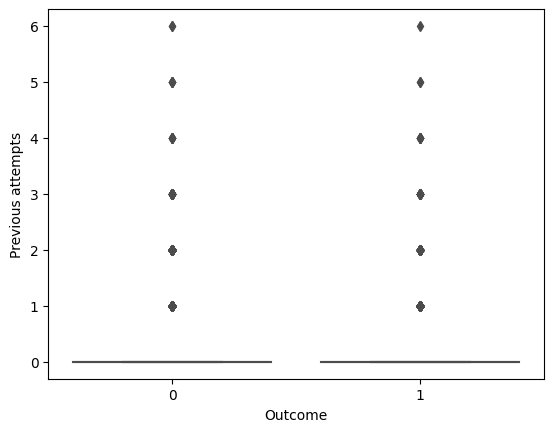

In [ ]:
sns.boxplot (x='Outcome', y='Previous attempts', data =data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Athlete score', ylabel='Train bf competition'>

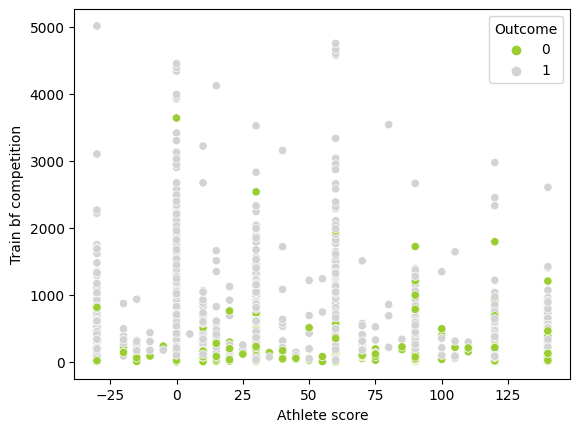

In [ ]:
sns.scatterplot(x='Athlete score', y='Train bf competition', hue='Outcome' , data=data, palette=['yellowgreen','lightgrey'])

<Axes: xlabel='Recovery', ylabel='Train bf competition'>

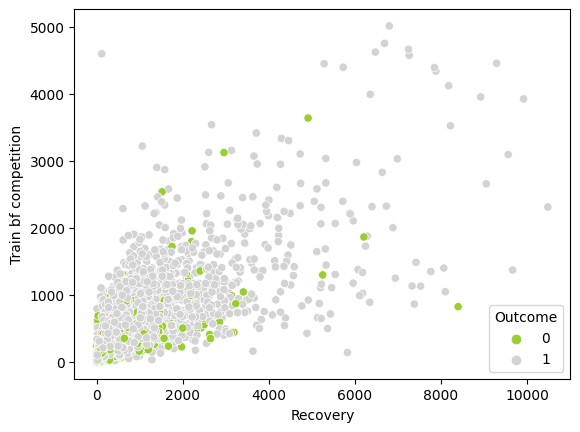

In [ ]:
sns.scatterplot(x='Recovery', y='Train bf competition', hue='Outcome' , data=data, palette=['yellowgreen','lightgrey'])

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Skewness,13.0,7.164707,8.679446,1.182775,3.844683,5.558629,6.34869,35.49531


In [ ]:
Amateur_data=data[(data['Train bf competition']<400) & (data['Cardiovascular training']<800) & (data['Cardiovascular training']<350) & (data['Recovery']<350) & (data['Sport-specific training']<30)]

In [ ]:
Prof_data=data[(data['Train bf competition']>400) & (data['Strength training']>600) & (data['Cardiovascular training']>800) & (data['Cardiovascular training']>350) & (data['Recovery']>350) & (data['Sport-specific training']>30)]

In [ ]:
Amateur_data.describe().T

,count,mean,std,min,25%,50%,75%,max
RecordID,9455.0,55245.672343,25999.462705,10001.0,32823.50,55107.0,77738.5,99989.0
Edition,9411.0,2020.716502,1.219903,2019.0,2019.00,2021.0,2022.0,2022.0
Athlete Id,9408.0,688773.593325,527056.492185,8462.0,505725.75,591577.0,644176.0,2698588.0
Previous attempts,9406.0,0.186477,0.519367,0.0,0.00,0.0,0.0,6.0
Athlete score,9410.0,15.140808,38.013971,-30.0,0.00,0.0,30.0,140.0
Train bf competition,9455.0,107.044950,77.615334,0.0,47.00,89.0,150.0,399.0
Strength training,9423.0,194.371219,252.593060,0.0,33.00,101.0,255.0,3625.0
Sand training,9407.0,1.657383,12.860737,0.0,0.00,0.0,0.0,1003.0
Recovery,9455.0,78.475410,85.274854,0.0,10.00,46.0,120.0,349.0
Supplements,9419.0,49.540079,56.367154,0.0,14.00,31.0,64.0,760.0


In [ ]:
Prof_data.describe().T

,count,mean,std,min,25%,50%,75%,max
RecordID,515.0,54645.462136,26747.258762,10128.0,31488.50,54601.0,78973.00,99654.0
Edition,515.0,2020.483495,1.184046,2019.0,2019.00,2020.0,2022.00,2022.0
Athlete Id,511.0,712430.336595,555575.182389,29335.0,523098.50,578497.0,644056.00,2683857.0
Previous attempts,514.0,0.128405,0.403506,0.0,0.00,0.0,0.00,4.0
Athlete score,515.0,21.000000,32.096341,-30.0,0.00,0.0,30.00,140.0
Train bf competition,515.0,980.357282,600.781256,401.0,620.50,809.0,1129.00,4752.0
Strength training,515.0,2434.174757,1180.037491,603.0,1654.00,2204.0,2939.50,9438.0
Sand training,515.0,2.460194,15.881488,0.0,0.00,0.0,0.00,197.0
Recovery,515.0,1092.846602,1082.531037,352.0,520.00,740.0,1199.00,9292.0
Supplements,512.0,573.660156,237.621864,120.0,410.75,517.0,683.25,1723.0


In [ ]:
prof_data=data[(data['Train bf competition']<300)]

In [ ]:
counts= prof_data['Outcome'].value_counts()
print(counts)

0    6574
1    6194
Name: Outcome, dtype: int64


In [ ]:
counts/len(data)

0    0.364110
1    0.343063
Name: Outcome, dtype: float64

In [ ]:
prof_data['Athlete score'].value_counts()

 0.0      6490
 60.0     2316
-30.0     1883
 30.0     1137
 120.0     271
 90.0      256
 140.0     172
 10.0       41
 15.0       28
-15.0       16
 20.0       14
 70.0       14
 75.0       12
 40.0       10
 45.0        7
-20.0        6
 105.0       4
 50.0        4
 110.0       4
 25.0        3
 100.0       3
 35.0        2
-10.0        2
 55.0        2
-5.0         2
 85.0        2
 80.0        1
Name: Athlete score, dtype: int64

In [ ]:
prof_data.describe().T

,count,mean,std,min,25%,50%,75%,max
RecordID,12768.0,55215.897478,26026.297140,10001.0,32616.5,55141.5,77726.75,99989.0
Edition,12701.0,2020.704118,1.200593,2019.0,2019.0,2021.0,2022.00,2022.0
Athlete Id,12706.0,689610.566583,528828.226461,8462.0,503624.5,589859.0,640204.75,2698588.0
Previous attempts,12701.0,0.175577,0.497273,0.0,0.0,0.0,0.00,6.0
Athlete score,12702.0,15.855771,37.184701,-30.0,0.0,0.0,30.00,140.0
Train bf competition,12768.0,126.505561,79.284458,0.0,59.0,115.0,187.00,299.0
Strength training,12716.0,240.823058,317.316310,0.0,42.0,124.0,319.00,6325.0
Sand training,12709.0,1.399874,7.498126,0.0,0.0,0.0,0.00,263.0
Recovery,12697.0,117.633063,170.431794,0.0,16.0,64.0,157.00,5823.0
Supplements,12707.0,69.038404,74.852243,0.0,18.0,41.0,96.00,748.0


In [ ]:
prof_data.describe(include = ['O']).T

,count,unique,top,freq
Competition,12706,7,Regional Tournament,3500
Sex,12704,2,M,6631
Region,12696,13,North America,1399
Education,12704,5,High school,5735
Age group,12699,4,0-35,9305
Income,12712,5,High,3554
Disability,12706,2,False,11443
Late enrollment,12707,2,False,12593
Cancelled enrollment,12710,2,False,9694
Mental preparation,12711,3,FALSE,12156


<Axes: xlabel='Outcome', ylabel='Train bf competition'>

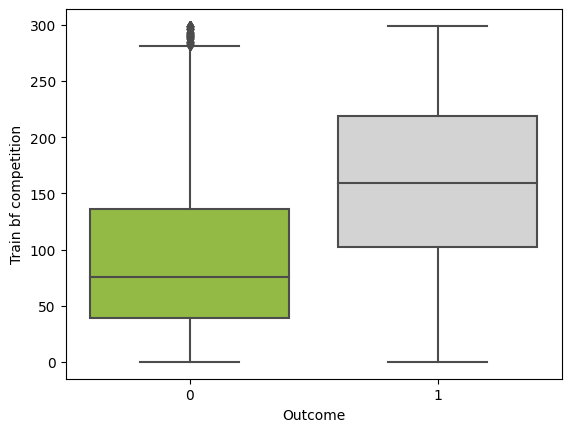

In [ ]:
sns.boxplot (x='Outcome', y='Train bf competition', data =prof_data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Outcome', ylabel='Strength training'>

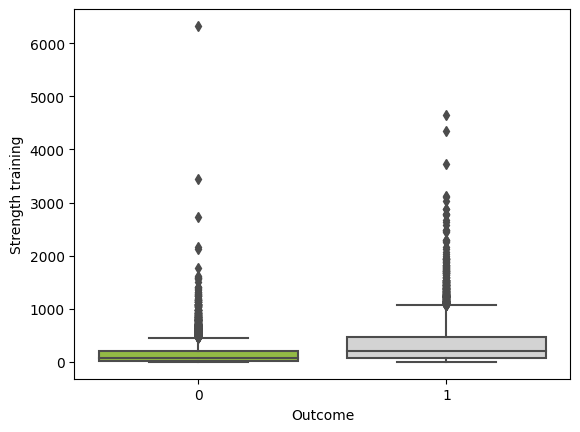

In [ ]:
sns.boxplot (x='Outcome', y='Strength training', data =prof_data, palette=["yellowgreen", "lightgrey"])

<Axes: xlabel='Recovery', ylabel='Train bf competition'>

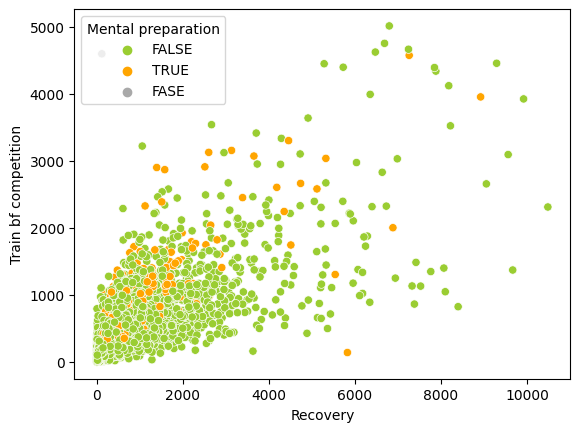

In [ ]:
sns.scatterplot(x='Recovery', y='Train bf competition', hue='Mental preparation' , data=data, palette=['yellowgreen','orange', 'darkgrey'])

In [ ]:
data_num=data[['Train bf competition', 'Strength training', 'Sand training', 'Recovery', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Plyometric training', 'Sport-specific training', 'Other training']].copy()

In [ ]:
#sns.pairplot(data = data_num, plot_kws ={'color': 'orange'}, diag_kws = {'color':'darkgrey'})

# <font color='#BFD72F'>**2. DATA PREPARATION**</font> <a class="anchor" id="import"></a>
[Back to Contents](#toc)

In [ ]:
data_backpack = data.copy()
test_backpack = test.copy()

In [ ]:
data = data.set_index(['RecordID'])
test = test.set_index(['RecordID'])

## <font color='#BFD72F'>**I. Handling Incoherences**</font> <a class="anchor" id="import"></a>
[Back to Contents](#toc)

Ensuring you have **good data quality** prior to running machine learning algorithms is a crucial step within the overall data science and machine learning workflow. The use of poor-quality data can lead to **severe degradation in the results** and have further consequences when decisions are made on those results.

Step 1 - Validate if there are any errors or incoherent values in the column  by applying the method .value_counts().

AND

Step 2 - Treat the incoherences found above by using the method replace() to replace the erros with the most appropriate values.

### a) Categorical Variables

AGE GROUP

In [ ]:
print(data['Age group'].value_counts())

#We have a incoherence for '<55' and just have 134 results

#Treat
data['Age group'].replace('0', np.nan, inplace = True)
data['Age group'].replace('55<=', '>=35', inplace = True)
data['Age group'].replace('35-55', '>=35', inplace = True)
data['Age group'].replace('0-35', '0-34', inplace = True)
print(f"Result for Age Group train dataset ': {data['Age group'].value_counts()}")
print("")

#test set
print(test['Age group'].value_counts())
test['Age group'].replace('0', np.nan, inplace = True)
test['Age group'].replace('55<=', '>=35', inplace = True)
test['Age group'].replace('35-55', '>=35', inplace = True)
test['Age group'].replace('0-35', '0-34', inplace = True)
print(f"Result for Age Group test dataset ': {test['Age group'].value_counts()}")

0-35     12470
35-55     5325
55<=       134
0           23
Name: Age group, dtype: int64
Result for Age Group train dataset ': 0-34    12470
>=35     5459
Name: Age group, dtype: int64

0-35     5350
35-55    2337
55<=       51
Name: Age group, dtype: int64
Result for Age Group test dataset ': 0-34    5350
>=35    2388
Name: Age group, dtype: int64


MENTAL PREPARATION

In [ ]:
print(f"Result of Mental preparation before transformation for train dataset': {data['Mental preparation'].value_counts()}")
print(f"Result of Mental preparation before transformation for test dataset': {test['Mental preparation'].value_counts()}")
#Treat
data['Mental preparation'].replace('FASE', 'FALSE', inplace = True)
print("")
print(f"Result of Mental preparation for train dataset': {data['Mental preparation'].value_counts()}")
print("")

#No problems on test dataset

Result of Mental preparation before transformation for train dataset': FALSE    16519
TRUE      1360
FASE        99
Name: Mental preparation, dtype: int64
Result of Mental preparation before transformation for test dataset': False    7171
True      567
Name: Mental preparation, dtype: int64

Result of Mental preparation for train dataset': FALSE    16618
TRUE      1360
Name: Mental preparation, dtype: int64



### b) Numeric Variables

Step 3 - Check if there are any values that don't make sense in the numeric variables

AND 

Step 4 - Treat the possible errors found above. Instead of just replacing the error with a missing value, replace it with the mean of the column (you can calculate the mean of a column by using the method .mean()).

In [ ]:
#Physioteherappy presents negativa values for train dataset. No problem with test dataset
data.loc[data['Physiotherapy'] < 0, 'Physiotherapy'] = data.loc[data['Physiotherapy'] < 0, 'Physiotherapy'].abs()

## <font color='#BFD72F'>II. Split</font> <a class="anchor" id="dummy"></a>

In [ ]:
#create X
X = data.drop('Outcome', axis = 1)
y = data[['Outcome']]

In [ ]:
#import train_test_split
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify = y, random_state=42)

## <font color='#BFD72F'>III. Treating Outliers</font> <a class="anchor" id="import"></a>
[Back to Contents](#toc)

In [ ]:
x_train_0 = x_train.copy()
x_test_0 = x_test.copy()

In [ ]:
x_train = x_train_0.copy()
x_test = x_test_0.copy()

#### Manually

In [ ]:
#manually
def remove_outliers(dataset):
    filters = (
        (dataset['Athlete score'] <= 125) &
        (dataset['Train bf competition'] <= 2000) &
        (dataset['Strength training'] <= 4000) &
        (dataset['Sand training'] <= 500) &
        (dataset['Recovery'] <= 5000) &
        (dataset['Supplements'] <= 1300) &
        (dataset['Cardiovascular training'] <= 5000) &
        (dataset['Squad training'] <= 100) &
        (dataset['Physiotherapy'] <= 1000) &
        (dataset['Sport-specific training'] <= 350) &
        (dataset['Other training'] <= 150)
    )
    return dataset[filters]

x_train_1 = remove_outliers(x_train)
x_test_1 = remove_outliers(x_test)

print('Percentage of data kept after removing outliers from x_train:', np.round(x_train_1.shape[0] / x_train.shape[0], 4))
print('Percentage of data kept after removing outliers from x_test:', np.round(x_test_1.shape[0] / x_test.shape[0], 4))

Percentage of data kept after removing outliers from x_train: 0.9196
Percentage of data kept after removing outliers from x_test: 0.918


In [ ]:
print(x_train.shape)

(14444, 28)


###Z-Score

In [ ]:
x_train_2 = x_train.copy()
x_test_2 = x_test.copy()

In [ ]:
datasets = [x_train_2, x_test_2]
threshold = 6
cols = ['Athlete score', 'Train bf competition', 'Strength training', 'Sand training', 'Recovery', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Sport-specific training', 'Other training']

x_train_2 = None
x_test_2 = None

for dataset in datasets:
    dataset_zscore = dataset.copy()

    def zscore(series):
        return (series - series.median()) / series.std()

    thisColumns = dataset_zscore[cols].describe().columns
    select = dataset_zscore[thisColumns].copy()
    zscoredf = select.apply(zscore)

    conditions = [(abs(zscoredf[col]) > threshold) for col in cols]
    zscoredf["Outlier"] = np.any(conditions, axis=0).astype(int)

    zscoredf = zscoredf[zscoredf['Outlier'] == 0]
    zscoredf = zscoredf['Outlier']
    dataset_zscore = dataset_zscore.merge(zscoredf, how='inner', on=["RecordID"])
    del dataset_zscore['Outlier']

    if x_train_2 is None:
        x_train_2 = dataset_zscore
    else:
        x_test_2 = dataset_zscore

    

print(f"Percentage of data kept after removing outliers {dataset_zscore.shape[0] / dataset.shape[0]:.4f}")


Percentage of data kept after removing outliers 0.9657


### Imputation and Iterative Removal of Outliers

In [ ]:
x_train_3 = x_train.copy()
x_test_3 = x_test.copy()

In [ ]:
num_variables = x_train.select_dtypes(include=['int', 'float']).columns

In [ ]:
num_variables = ['Previous attempts', 'Athlete score',
       'Train bf competition', 'Strength training', 'Sand training',
       'Recovery', 'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Plyometric training', 'Sport-specific training',
       'Other training']

In [ ]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.neighbors import LocalOutlierFactor

# Função para remover outliers usando IIRO
def remove_outliers_with_missing(data, iterations=3):
    for i in range(iterations):
        # Passo 1: Imputação de valores ausentes
        imputer = SimpleImputer(strategy='mean')
        data_imputed = imputer.fit_transform(data)
        
        # Passo 2: Detecção de outliers
        detector = LocalOutlierFactor()
        outlier_scores = detector.fit_predict(data_imputed)
        
        # Passo 3: Remoção de outliers
        data = data[outlier_scores > 0]
    
    return data

# Aplicar a remoção de outliers no DataFrame x_train_2[num_variables]
x_train_3 = remove_outliers_with_missing(x_train_3[num_variables])

# Imprimir o DataFrame sem outliers
print(x_train_3)

# Loop para aplicar a remoção de outliers em result_xtest_2
x_test_3 = remove_outliers_with_missing(x_test_3[num_variables])

# Imprimir o DataFrame sem outliers
print(x_test_3)


          Previous attempts  Athlete score  Train bf competition  \
RecordID                                                           
99242                   0.0            0.0                 387.0   
65381                   1.0           60.0                 191.0   
73802                   0.0            0.0                 286.0   
70149                   0.0            0.0                 260.0   
78872                   0.0           60.0                 128.0   
...                     ...            ...                   ...   
65021                   0.0          -30.0                 200.0   
23255                   0.0            0.0                 523.0   
63370                   0.0            0.0                 108.0   
49985                   0.0            NaN                 587.0   
47237                   0.0           30.0                 666.0   

          Strength training  Sand training  Recovery  Supplements  \
RecordID                                      

In [ ]:
print(f"Percentage of data kept after removing outliers x_train {x_train_3.shape[0] / x_train_0.shape[0]:.4f}")

print(f"Percentage of data kept after removing outliers x_test {x_test_3.shape[0] / x_test_0.shape[0]:.4f}")

Percentage of data kept after removing outliers x_train 0.9808
Percentage of data kept after removing outliers x_test 0.9621


In [ ]:
# Obter os índices presentes no result_x_train_2
indices_to_keep = x_train_3.index

# Fazer o drop das linhas em x_train que não estejam presentes nos índices a serem mantidos
x_train_3 = x_train.loc[indices_to_keep]

In [ ]:
# Obter os índices presentes no result_x_train_2
indices_to_keep = x_test_3.index

# Fazer o drop das linhas em x_train que não estejam presentes nos índices a serem mantidos
x_test_3 = x_test.loc[indices_to_keep]

### DBSCAN

In [ ]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.cluster import DBSCAN

# Function to remove outliers using DBSCAN
def remove_outliers_with_dbscan(data, eps=900, min_samples=5):
    # Step 1: Imputation of missing values
    imputer = SimpleImputer(strategy='mean')
    data_imputed = imputer.fit_transform(data)

    # Step 2: Detection of outliers using DBSCAN
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    outlier_labels = dbscan.fit_predict(data_imputed)

    # Step 3: Removal of outliers
    data = data[outlier_labels != -1]

    return data

# Apply outlier removal using DBSCAN on the DataFrame result_x_train_2
x_train_5 = remove_outliers_with_dbscan(x_train[num_variables])

# Loop to apply outlier removal using DBSCAN on the DataFrame result_xtest_2
x_test_5 = remove_outliers_with_dbscan(x_test[num_variables])

print(f"Percentage of data kept after removing outliers x_train {x_train_5.shape[0] / x_train.shape[0]:.4f}")

print(f"Percentage of data kept after removing outliers x_test {x_test_5.shape[0] / x_test.shape[0]:.4f}")


Percentage of data kept after removing outliers x_train 0.9941
Percentage of data kept after removing outliers x_test 0.9859


### Treating Selection

* 0 : No one
* 1 : Mannualy
* 2 : Z-Score
* 3 : MAD
* 4 : Mahalanobis distance
* 5 : DBSCAN

In [ ]:
x_train = x_train_2.copy()
x_test = x_test_2.copy()

## <font color='#BFD72F'>IV. Handling Missing Values</font> <a class="anchor" id="import"></a>
[Back to Contents](#toc)

Daniel T. Larose, Chantal D. Larose (2015) “Data Mining and Predictive Analytics,” 2nd Edition, Wiley (pp. 22-25)</font><br>
[Back to Contents](#toc)

Missing data is a problem that continues to plague data analysis methods. Even as our analysis methods gain sophistication, we nevertheless continue to encounter missing values in fields, especially in databases with a large number of fields. The **absence of information is rarely beneficial**. All things being equal, more information is almost always better. Therefore, we should think carefully about how we handle the thorny issue of missing data.

### Athlete Id

In [ ]:
print(f"Number of NaNs in 'Athlete Id' in x_train: {x_train['Athlete Id'].isna().sum()}")
print(f"Number of NaNs in 'Athlete Id' in x_test: {x_test['Athlete Id'].isna().sum()}")
print(f"Number of NaNs in 'Athlete Id' in test dataset: {test['Athlete Id'].isna().sum()}") #no NaN
#print("")
import random

# Loop through x_train and x_test
for data in [x_train, x_test]:
    # Find the maximum value in the 'Athlete Id' column
    max_id = data['Athlete Id'].max()

    # Generate a random number greater than the maximum value
    random_number = random.randint(max_id + 1, max_id + 100)  # Adjust the range as needed

    # Replace the missing values with the generated random number
    data['Athlete Id'].fillna(random_number, inplace=True)

print("")
print(f"Number of NaNs in 'Athlete Id in x_train': {x_train['Athlete Id'].isna().sum()}")
print(f"Number of NaNs in 'Athlete Id in x_test': {x_test['Athlete Id'].isna().sum()}")

Number of NaNs in 'Athlete Id' in x_train: 73
Number of NaNs in 'Athlete Id' in x_test: 15
Number of NaNs in 'Athlete Id' in test dataset: 0

Number of NaNs in 'Athlete Id in x_train': 0
Number of NaNs in 'Athlete Id in x_test': 0


In [ ]:
numeric_variables = x_train.select_dtypes(include=['int', 'float', 'uint8']).columns
non_numeric_metrics = [col for col in x_train.columns if col not in numeric_variables]
numeric_variables

Index(['Edition', 'Athlete Id', 'Previous attempts', 'Athlete score',
       'Train bf competition', 'Strength training', 'Sand training',
       'Recovery', 'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Plyometric training', 'Sport-specific training',
       'Other training'],
      dtype='object')


Due to all the cons of simply deleting missing values, data analysts have turned to methods that would replace the missing value with a value substituted according to various criteria. Some common criteria for choosing replacement values for missing data are as follows:
-  Replace the missing value with some **constant**;
-  Replace the missing value with the field **mean** (for numeric variables) or the **mode** (for categorical variables);
-  Replace the missing values with a value generated at **random** from the observed distribution of the variable;
-  Replace the missing values with **imputed values based on the other characteristics** of the record.


The method `fillna()` is used to replace missing values with a value of our choosing. You can check the documentation on this method with explanations on how to set the parameters <a href=https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.fillna.html> here</a>.

**Step 22** - By using the method `fillna()` with the parameter `value` set to 0, change the missing values in the dataset to the value 0. Create a new dataset named `data_fill0` when applying this replacement.

### Others Features using median and mode

In [ ]:
#replacing missing values for x_train:
for col in non_numeric_metrics:
    x_train[col].fillna(x_train[col].mode()[0], inplace=True)
print(f'Number of missing values for categorical data in x_train:\n{x_train[non_numeric_metrics].isna().sum()}\n')

for metric in numeric_variables:
    x_train[metric].fillna(x_train[col].median(), inplace=True)
print(f'Number of missing values for numeric data in x_train:\n{x_train[numeric_variables].isna().sum()}\n')

#replacing missing values in x_test with median and modes from x_train:
for col in non_numeric_metrics:
    x_test[col].fillna(x_train[col].mode()[0], inplace=True)
print(f'Number of missing values for categorical data in x_test:\n{x_test[non_numeric_metrics].isna().sum()}\n')

for metric in numeric_variables:
    x_test[metric].fillna(x_train[col].median(), inplace=True)
print(f'Number of missing values for numeric data in x_test:\n{x_test[numeric_variables].isna().sum()}\n')

Number of missing values for categorical data in x_train:
Competition             0
Sex                     0
Region                  0
Education               0
Age group               0
Income                  0
Disability              0
Late enrollment         0
Cancelled enrollment    0
Mental preparation      0
Outdoor Workout         0
No coach                0
Past injuries           0
dtype: int64

Number of missing values for numeric data in x_train:
Edition                    0
Athlete Id                 0
Previous attempts          0
Athlete score              0
Train bf competition       0
Strength training          0
Sand training              0
Recovery                   0
Supplements                0
Cardiovascular training    0
Squad training             0
Physiotherapy              0
Plyometric training        0
Sport-specific training    0
Other training             0
dtype: int64

Number of missing values for categorical data in x_test:
Competition             0
Sex 

### Other Features using random

In [ ]:
"""import numpy as np

# Replacing missing values for x_train
for col in non_numeric_metrics:
    x_train[col].fillna(np.random.choice(x_train[col].dropna()), inplace=True)
print(f'Number of missing values for categorical data in x_train:\n{x_train[non_numeric_metrics].isna().sum()}\n')

for metric in numeric_metrics:
    x_train[metric].fillna(np.random.normal(x_train[col].mean(), x_train[col].std()), inplace=True)
print(f'Number of missing values for numeric data in x_train:\n{x_train[numeric_metrics].isna().sum()}\n')

# Replacing missing values in x_test with random values
for col in non_numeric_metrics:
    x_test[col].fillna(np.random.choice(x_train[col].dropna()), inplace=True)
print(f'Number of missing values for categorical data in x_test:\n{x_test[non_numeric_metrics].isna().sum()}\n')

for metric in numeric_metrics:
    x_test[metric].fillna(np.random.normal(x_train[col].mean(), x_train[col].std()), inplace=True)
print(f'Number of missing values for numeric data in x_test:\n{x_test[numeric_metrics].isna().sum()}\n')"""


"import numpy as np\n\n# Replacing missing values for x_train\nfor col in non_numeric_metrics:\n    x_train[col].fillna(np.random.choice(x_train[col].dropna()), inplace=True)\nprint(f'Number of missing values for categorical data in x_train:\n{x_train[non_numeric_metrics].isna().sum()}\n')\n\nfor metric in numeric_metrics:\n    x_train[metric].fillna(np.random.normal(x_train[col].mean(), x_train[col].std()), inplace=True)\nprint(f'Number of missing values for numeric data in x_train:\n{x_train[numeric_metrics].isna().sum()}\n')\n\n# Replacing missing values in x_test with random values\nfor col in non_numeric_metrics:\n    x_test[col].fillna(np.random.choice(x_train[col].dropna()), inplace=True)\nprint(f'Number of missing values for categorical data in x_test:\n{x_test[non_numeric_metrics].isna().sum()}\n')\n\nfor metric in numeric_metrics:\n    x_test[metric].fillna(np.random.normal(x_train[col].mean(), x_train[col].std()), inplace=True)\nprint(f'Number of missing values for numeric d

## <font color='#BFD72F'>III. Treating Outliers </font> <a class="anchor" id="dummy"></a>

Nesta secção voltamos à parte do tratamento de dados, para o caso em que tenhamos escolhido na secção anterior não tratar os dados, para tratar primeiramente dos Missing Values e, posteriormente, tratar de outliers com recursos a algoritmos próprios.

### IsolationForest

In [ ]:
"""from sklearn.ensemble import IsolationForest

# Create an instance of the Isolation Forest model
isolation_forest = IsolationForest(contamination='auto', random_state=42)

# Loop through x_train and x_test
datasets = [x_train, x_test]

for i, data in enumerate(datasets):
    # Fit the model to the data
    isolation_forest.fit(data)

    # Predict the anomaly score for each data point
    anomaly_scores = isolation_forest.decision_function(data)

    # Identify the outliers
    outliers = data[anomaly_scores < 0]

    # Remove the outliers from the dataset
    data_6 = data[anomaly_scores >= 0]
    if i == 0:
        x_train_6 = data_6
        y_train_6 = y_train.loc[x_train_6.index]
    elif i == 1:
        x_test_6 = data_6
        y_test_6 = y_test.loc[x_test_6.index]

x_train = x_train_6.copy()
x_test = x_test_6.copy()
y_train = y_train_6.copy()
y_test = y_test_6.copy()"""



"from sklearn.ensemble import IsolationForest\n\n# Create an instance of the Isolation Forest model\nisolation_forest = IsolationForest(contamination='auto', random_state=42)\n\n# Loop through x_train and x_test\ndatasets = [x_train, x_test]\n\nfor i, data in enumerate(datasets):\n    # Fit the model to the data\n    isolation_forest.fit(data)\n\n    # Predict the anomaly score for each data point\n    anomaly_scores = isolation_forest.decision_function(data)\n\n    # Identify the outliers\n    outliers = data[anomaly_scores < 0]\n\n    # Remove the outliers from the dataset\n    data_6 = data[anomaly_scores >= 0]\n    if i == 0:\n        x_train_6 = data_6\n        y_train_6 = y_train.loc[x_train_6.index]\n    elif i == 1:\n        x_test_6 = data_6\n        y_test_6 = y_test.loc[x_test_6.index]\n\nx_train = x_train_6.copy()\nx_test = x_test_6.copy()\ny_train = y_train_6.copy()\ny_test = y_test_6.copy()"

## <font color='#BFD72F'>IV. Transform data types and Enconding</font> <a class="anchor" id="dummy"></a>


The choice between ordinal encoding and one-hot encoding depends on the type of data and the algorithm you are using.

Ordinal encoding is used when the categorical features have a natural ordering to them, for example, low, medium, high. In ordinal encoding, each category is assigned a numerical value based on its order. This can be useful when using algorithms like decision trees or linear regression.

On the other hand, one-hot encoding is used when the categorical features do not have a natural ordering, for example, colors, or countries. In one-hot encoding, a new binary feature is created for each category, and a value of 1 is assigned to the corresponding category for each observation. This can be useful when using algorithms like neural networks or support vector machines.

So, the choice between ordinal encoding and one-hot encoding depends on the nature of your categorical variables, the machine learning model you are using, and the goals of your analysis.

In [ ]:
y_train = y_train[y_train.index.isin(x_train.index)]

In [ ]:
y_test = y_test[y_test.index.isin(x_test.index)]

**Encode Age Group Feature**

__1_ : Represents 0-34 years -> Young

__0__ : Represents equal or more 35 years - Adult or senior bold text

In [ ]:
#Transform 
for data in [x_train, x_test, test]:
    data['Age group'].replace('0-34', 1, inplace=True)
    data['Age group'].replace('>=35', 0, inplace=True)
    data['Age group'] = data['Age group'].astype(int)

**Enconde Sex Feature**

__0__ : Represents Masculine <br>
__1__ : Represents Females

In [ ]:
for data in [x_train, x_test, test]:
    data['Sex'].replace('M', 0, inplace=True)
    data['Sex'].replace('F', 1, inplace=True)
    data['Sex'] = data['Sex'].astype(int)

**Enconde Edition Feature**

0 : 2019

1 : 2020 

2 : 2021

3 : 2022

In [ ]:
for data in [x_train, x_test, test]:
    data['Edition'].replace(2019, 0, inplace=True)
    data['Edition'].replace(2020, 1, inplace=True)
    data['Edition'].replace(2021, 2, inplace=True)
    data['Edition'].replace(2022, 3, inplace=True)

In [ ]:
x_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3487 entries, 13665 to 39968
Data columns (total 28 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Competition              3487 non-null   object 
 1   Edition                  3487 non-null   float64
 2   Athlete Id               3487 non-null   float64
 3   Sex                      3487 non-null   int64  
 4   Region                   3487 non-null   object 
 5   Education                3487 non-null   object 
 6   Age group                3487 non-null   int64  
 7   Income                   3487 non-null   object 
 8   Disability               3487 non-null   bool   
 9   Previous attempts        3487 non-null   float64
 10  Late enrollment          3487 non-null   bool   
 11  Cancelled enrollment     3487 non-null   bool   
 12  Athlete score            3487 non-null   float64
 13  Mental preparation       3487 non-null   object 
 14  Train bf competitio

**Enconde Mental Preparation Feature**

0 : Represents No Mental Preparation

1 : Represents Mental Preparation

In [ ]:
for data in [x_train, x_test, test]:
    data['Mental preparation'].replace('FALSE', 0, inplace=True)
    data['Mental preparation'].replace('TRUE', 1, inplace=True)
    data['Mental preparation'].replace('False', 0, inplace=True)
    data['Mental preparation'].replace('True', 1, inplace=True)
    data['Mental preparation'] = data['Mental preparation'].astype(int)

**Encode Income Feature**

In [ ]:
for data in [x_train, x_test, test]:
    data['Income'].replace('Low', 0, inplace=True)
    data['Income'].replace('Middle-Low', 0, inplace=True)
    data['Income'].replace('Middle', 1, inplace=True)
    data['Income'].replace('Middle-High', 1, inplace=True)
    data['Income'].replace('High', 2, inplace=True)
    data['Income'] = data['Income'].astype(int)

In [ ]:
for data in [x_train, x_test, test]:
    data['Education'].replace('Elementary school', 1, inplace=True)
    data['Education'].replace('Middle school', 2, inplace=True)
    data['Education'].replace('High school', 3, inplace=True)
    data['Education'].replace('University Degree', 5, inplace=True)
    data['Education'].replace('Post Graduate', 5, inplace=True)
    data['Education'] = data['Education'].astype(int)

In [ ]:
for data in [x_train, x_test, test]:
    data['Competition_encoded'] = data['Competition']
    data['Competition_encoded'].replace('Local Match', 0, inplace=True)
    data['Competition_encoded'].replace('Regional Tournament', 1, inplace=True)
    data['Competition_encoded'].replace('Continental Championship', 2, inplace=True)
    data['Competition_encoded'].replace('National Cup', 3, inplace=True)
    data['Competition_encoded'].replace('Federation League', 5, inplace=True)
    data['Competition_encoded'].replace('World Championship', 5, inplace=True)
    data['Competition_encoded'].replace('Olympic Games', 5, inplace=True)

In [ ]:
"""# Perform One-Hot Encoding for the 'Region' variable
x_train_encoded = pd.get_dummies(x_train, columns=['Competition'])
x_test_encoded = pd.get_dummies(x_test, columns=['Competition'])
test_encoded = pd.get_dummies(test, columns=['Competition'])

x_train = x_train_encoded.copy()
x_test = x_test_encoded.copy()
test = test_encoded.copy()"""

"# Perform One-Hot Encoding for the 'Region' variable\nx_train_encoded = pd.get_dummies(x_train, columns=['Competition'])\nx_test_encoded = pd.get_dummies(x_test, columns=['Competition'])\ntest_encoded = pd.get_dummies(test, columns=['Competition'])\n\nx_train = x_train_encoded.copy()\nx_test = x_test_encoded.copy()\ntest = test_encoded.copy()"

**Encode others features**

In [ ]:
def transform_data(data):
    data['Disability'] = data['Disability'].astype(int)
    data['No coach'] = data['No coach'].astype(int)
    data['Outdoor Workout'] = data['Outdoor Workout'].astype(int)
    data['Past injuries'] = data['Past injuries'].astype(int)
    data['Late enrollment'] = data['Late enrollment'].astype(int)
    data['Cancelled enrollment'] = data['Cancelled enrollment'].astype(int)
    return data

# Apply the transform_data function to each dataset
x_train = transform_data(x_train)
x_test = transform_data(x_test)
test = transform_data(test)

In [ ]:
x_train_copy = x_train.copy()
x_test_copy = x_test.copy()
test_copy = test.copy()

In [ ]:
x_train = x_train_copy.copy()
x_test = x_test_copy.copy()
test = test_copy.copy()

## <font color='#BFD72F'>V. Feature Engineering</font> <a class="anchor" id="engineering"></a>
[Back to Contents](#toc)

**Feature engineering** is the process of manipulating, and transforming raw data into features that can be used to boost our machine learning models.
<br><br>

In [ ]:
print(x_train.describe(include = ['O']).T)

test.describe(include = ['O']).T

             count unique            top  freq
Competition  13956      7    Local Match  3444
Region       13956     13  North America  1620


,count,unique,top,freq
Competition,7738,7,Local Match,1860
Region,7738,13,North America,820


#### a) Region_Categ

In [ ]:
for data in [x_train, x_test, test]:
  # Create a new categoric variable for regions in x_train
  data['Region'].replace('Western Europe', 'Europe', inplace = True)
  data['Region'].replace('East Asia', 'Asia', inplace = True)
  data['Region'].replace('Northern Africa', 'Africa', inplace = True)
  data['Region'].replace('Eastern Europe', 'Europe', inplace = True)
  data['Region'].replace('Middle East', 'Asia', inplace = True)
  data['Region'].replace('Central Asia', 'Asia', inplace = True)
  data['Region'].replace('Central America', 'America', inplace = True)
  data['Region'].replace('North America', 'America', inplace = True)
  data['Region'].replace('South America', 'America', inplace = True)
  data['Region'].replace('Southern Europe', 'Europe', inplace = True)
  data['Region'].replace('South Asia', 'Asia', inplace = True)
  data['Region'].replace('Southern Africa', 'Africa', inplace = True)

In [ ]:
# Perform One-Hot Encoding for the 'Region' variable
x_train_encoded = pd.get_dummies(x_train, columns=['Region'])
x_test_encoded = pd.get_dummies(x_test, columns=['Region'])
test_encoded = pd.get_dummies(test, columns=['Region'])

x_train = x_train_encoded.copy()
x_test = x_test_encoded.copy()
test = test_encoded.copy()

### b) Training Diversity

In [ ]:
for df in [x_train, x_test, test]:
  # create a list of the column names for the training features
  training_cols = ['Train bf competition', 'Strength training', 'Sand training', 'Cardiovascular training', 'Squad training', 'Plyometric training', 'Sport-specific training', 'Other training']

  # create a new column that counts the number of non-zero training features for each row
  df['Training Diversity'] = (df[training_cols] != 0).sum(axis=1)


### c) Recovery Total

In [ ]:
for df in [x_train, x_test, test]:
  df['Recovery Total'] = df[['Recovery', 'Physiotherapy']].sum(axis=1)


###d) Training Duration
represents the overall training duration of an athlete by considering variables of training sessions across categories to determine the overall training duration.

In [ ]:
# Create a new numeric variable for total number of training sessions in x_train
x_train['Training Duration'] = x_train[['Other training', 'Sand training', 'Sport-specific training','Squad training', 'Strength training','Cardiovascular training','Plyometric training','Train bf competition' ]].sum(axis=1)
print('x_train:', x_train['Training Duration'].value_counts())

# Create a new numeric variable for total number of training sessions in x_test
x_test['Training Duration'] = x_test[['Other training', 'Sand training', 'Sport-specific training','Squad training', 'Strength training','Cardiovascular training','Plyometric training','Train bf competition' ]].sum(axis=1)
print('x_test:', x_test['Training Duration'].value_counts())

# Create a new numeric variable for total number of training sessions in test dataset
test['Training Duration'] = test[['Other training', 'Sand training', 'Sport-specific training','Squad training', 'Strength training','Cardiovascular training','Plyometric training','Train bf competition' ]].sum(axis=1)
print('test:', test['Training Duration'].value_counts())

x_train: 278.0     25
216.0     23
140.0     23
232.0     23
174.0     23
          ..
3657.0     1
2378.0     1
2475.0     1
2674.0     1
3426.0     1
Name: Training Duration, Length: 3253, dtype: int64
x_test: 217.0     11
167.0     10
413.0     10
180.0      9
281.0      8
          ..
1418.0     1
881.0      1
754.0      1
1089.0     1
1158.0     1
Name: Training Duration, Length: 1736, dtype: int64
test: 180.0     18
274.0     16
163.0     15
164.0     15
267.0     15
          ..
1703.0     1
2395.0     1
1569.0     1
2453.0     1
2712.0     1
Name: Training Duration, Length: 2689, dtype: int64


###e) Training Volume
a categorical variable that indicates the volume and intensity of preparation having in account the total number of training sessions

* 0 low volume
* 1 medium volume
* 2 high volume

In [ ]:
# Create a new categorical variable for training volume in x_train
x_train['Training Volume'] = pd.cut(x_train['Training Duration'], bins=[0, 500, 1000, float('inf')], labels=['0', '1', '2'], right=False)
print('x_train:', x_train['Training Volume'].value_counts())

# Create a new categorical variable for training volume in x_test
x_test['Training Volume'] = pd.cut(x_test['Training Duration'], bins=[0, 500, 1000, float('inf')], labels=['0', '1', '2'], right=False)
print('x_test:', x_test['Training Volume'].value_counts())

# Create a new categorical variable for training volume in test
test['Training Volume'] = pd.cut(test['Training Duration'], bins=[0, 500, 1000, float('inf')], labels=['0', '1', '2'], right=False)
print('test:', test['Training Volume'].value_counts())

x_train: 0    6549
2    4353
1    3054
Name: Training Volume, dtype: int64
x_test: 0    1626
2    1056
1     805
Name: Training Volume, dtype: int64
test: 0    3489
2    2552
1    1697
Name: Training Volume, dtype: int64


###f) Training Commitment
new variable that represents an athlete's level of commitment to training by considering variables such as Training sessions before competition and Late enrollment


---
* 1 represent highly commitment
* 0 not highly commitment


In [ ]:
# Create a new categorical variable for Training Commitment in x_train
x_train['Training Commitment'] = x_train[['Train bf competition', 'Late enrollment']].apply(lambda row: '1' if row[0] > 200 and not row[1] else '0', axis=1)
print('x_train:', x_train['Training Commitment'].value_counts())
# Create a new categorical variable for Training Commitment in x_test
x_test['Training Commitment'] = x_test[['Train bf competition', 'Late enrollment']].apply(lambda row: '1' if row[0] > 200 and not row[1] else '0', axis=1)
print('x_test:', x_train['Training Commitment'].value_counts())
# Create a new categorical variable for Training Commitment in test
test['Training Commitment'] = test[['Train bf competition', 'Late enrollment']].apply(lambda row: '1' if row[0] > 200 and not row[1] else '0', axis=1)
print('test:', x_train['Training Commitment'].value_counts())

x_train: 0    8152
1    5804
Name: Training Commitment, dtype: int64
x_test: 0    8152
1    5804
Name: Training Commitment, dtype: int64
test: 0    8152
1    5804
Name: Training Commitment, dtype: int64


In [ ]:
for data in [x_train, x_test,test]:
    data['Training Volume'] = data['Training Volume'].astype(int)
    data['Training Commitment'] = pd.to_numeric(data['Training Commitment'], errors='coerce')

### g) Performance Index

In [ ]:
import numpy as np
teste = pd.concat([x_train, y_train], axis=1)

# Define the variables
variables = ['Training Diversity', 'Mental preparation', 'Training Duration', 'Recovery Total', 'Training Commitment']

datasets = [teste]

target_variable = 'Performance Index'  # Replace with the actual name of your target variable

for i, data in enumerate(datasets):
    # Normalize the continuous variables using min-max scaling
    continuous_vars = ['Training Diversity', 'Training Duration', 'Recovery Total', 'Training Commitment']
    data_normalized = (data[continuous_vars] - data[continuous_vars].min()) / (data[continuous_vars].max() - data[continuous_vars].min())

    # Convert 'Mental preparation' to numeric (assuming 1 for Yes and 0 for No)
    data_normalized['Mental preparation'] = pd.to_numeric(data['Mental preparation'])

    # Initialize weights
    weights = np.array([0.1, 0.1, 0.3, 0.3, 0.2])

    # Define the learning rate
    learning_rate = 0.01

    # Define the number of iterations
    num_iterations = 1000

    # Perform gradient descent
    for _ in range(num_iterations):
        # Calculate the performance index using the current weights
        performance_index = data_normalized[continuous_vars].dot(weights[:-1]) + data_normalized['Mental preparation'] * weights[-1]

        # Calculate the correlation between the performance index and the target variable
        correlation = np.corrcoef(performance_index, data['Outcome'])[0, 1]

        # Update the weights using gradient descent
        gradient = data_normalized[continuous_vars].T.dot(data['Outcome'] - performance_index) / len(data)
        weights[:-1] += learning_rate * gradient
        weights[-1] += learning_rate * np.mean(data_normalized['Mental preparation'] * (data['Outcome'] - performance_index))

    # Calculate the performance index with the optimized weights
    performance_index = data_normalized[continuous_vars].dot(weights[:-1]) + data_normalized['Mental preparation'] * weights[-1]

    # Normalize the performance index
    performance_index = (performance_index - performance_index.min()) / (performance_index.max() - performance_index.min())

    if i == 0:
        x_train['Performance Index'] = performance_index
    elif i == 1:
        x_test['Performance Index'] = performance_index
    elif i == 2:
        test['Performance Index'] = performance_index

    print("Final weights:", weights)

Final weights: [0.58556158 0.18962391 0.33656651 0.35776701 0.17116072]


In [ ]:
# Define the variables
variables = ['Training Diversity', 'Mental preparation', 'Training Duration', 'Recovery Total', 'Training Commitment']

datasets = [x_train, x_test, test]

for i, data in enumerate(datasets):
    # Normalize the continuous variables using min-max scaling
    continuous_vars = ['Training Diversity', 'Training Duration', 'Recovery Total','Training Commitment']
    data_normalized = (data[continuous_vars] - data[continuous_vars].min()) / (data[continuous_vars].max() - data[continuous_vars].min())

    # Convert 'Mental preparation' to numeric (assuming 1 for Yes and 0 for No)
    data_normalized['Mental preparation'] = pd.to_numeric(data['Mental preparation'])

    # Assign weights to the variables
    weights = [0.60673361, 0.15338218, 0.32339268, 0.40030952, 0.17754576]

    # Calculate the performance index
    data_normalized['performance_index'] = data_normalized[continuous_vars].dot(weights[:-1])
    data_normalized['performance_index'] += data_normalized['Mental preparation'] * weights[-1]

    # Normalize the performance index
    data_normalized['performance_index'] = (data_normalized['performance_index'] - data_normalized['performance_index'].min()) / (data_normalized['performance_index'].max() - data_normalized['performance_index'].min())

    if i == 0:
        x_train['Performance Index'] = data_normalized['performance_index']
    elif i == 1:
        x_test['Performance Index'] = data_normalized['performance_index']
    elif i == 2:
        test['Performance Index'] = data_normalized['performance_index']


### h) Risk Index

In [ ]:
teste = pd.concat([x_train, y_train], axis=1)
# Define the variables
variables = ['Past injuries', 'Mental preparation', 'Cancelled enrollment', 'Previous attempts', 'Physiotherapy']

datasets = [teste]

for i, data in enumerate(datasets):
    # Normalize the continuous variables using min-max scaling
    continuous_vars = ['Past injuries', 'Cancelled enrollment', 'Previous attempts', 'Physiotherapy']
    data_normalized = (data[continuous_vars] - data[continuous_vars].min()) / (data[continuous_vars].max() - data[continuous_vars].min())

    # Convert 'Mental preparation' and 'No coach' to numeric (assuming 1 for Yes and 0 for No)
    data_normalized['Mental preparation'] = pd.to_numeric(data['Mental preparation'])
    data_normalized['No coach'] = pd.to_numeric(data['No coach'])

    # Assign initial weights
    initial_weights = np.array([0.1, 0.1, 0.3, 0.3, 0.1])

    # Define the learning rate
    learning_rate = 0.01

    # Define the number of iterations
    num_iterations = 1000

    # Perform gradient descent
    weights = initial_weights.copy()

    for _ in range(num_iterations):
        # Calculate the risk index using the current weights
        risk_index = data_normalized[continuous_vars].dot(weights[:-1]) + data_normalized['Mental preparation'] * weights[-1]

        # Calculate the correlation between the risk index and the target variable
        correlation = np.corrcoef(risk_index, data['Outcome'])[0, 1]

        # Update the weights using gradient descent
        gradient = data_normalized[continuous_vars].T.dot(data['Outcome'] - risk_index) / len(data)
        weights[:-1] += learning_rate * gradient
        weights[-1] += learning_rate * np.mean(data_normalized['Mental preparation'] * (data['Outcome'] - risk_index))

    # Calculate the risk index with the optimized weights
    risk_index = data_normalized[continuous_vars].dot(weights[:-1]) + data_normalized['Mental preparation'] * weights[-1]

    # Normalize the risk index
    risk_index = (risk_index - risk_index.min()) / (risk_index.max() - risk_index.min())

    if i == 0:
        teste['risk_index'] = risk_index
    
    print("Final weights:", weights)


Final weights: [ 0.63955317 -0.19612076  0.31109099  0.44300059  0.22924387]


In [ ]:
# Define the variables
variables = ['Past injuries', 'Mental preparation', 'Cancelled enrollment', 'Previous attempts','Physiotherapy']

datasets = [x_train, x_test, test]

for i, data in enumerate(datasets):
    # Normalize the continuous variables using min-max scaling
    continuous_vars = ['Past injuries', 'Cancelled enrollment', 'Previous attempts','Physiotherapy']
    data_normalized = (data[continuous_vars] - data[continuous_vars].min()) / (data[continuous_vars].max() - data[continuous_vars].min())

    # Convert 'Mental preparation' and 'No coach' to numeric (assuming 1 for Yes and 0 for No)
    data_normalized['Mental preparation'] = pd.to_numeric(data['Mental preparation'])
    data_normalized['No coach'] = pd.to_numeric(data['No coach'])

    # Assign weights to the variables
    weights = [0.67327554, -0.19803501,  0.31152997,  0.36048684, 0.22442404]

    # Calculate the risk index
    data_normalized['risk_index'] = data_normalized[continuous_vars].dot(weights[:-1])
    data_normalized['risk_index'] += data_normalized['Mental preparation'] * weights[-1]

    # Normalize the risk index
    data_normalized['risk_index'] = (data_normalized['risk_index'] - data_normalized['risk_index'].min()) / (data_normalized['risk_index'].max() - data_normalized['risk_index'].min())

    if i == 0:
        x_train['risk_index'] = data_normalized['risk_index']
    elif i == 1:
        x_test['risk_index'] = data_normalized['risk_index']
    elif i == 2:
        test['risk_index'] = data_normalized['risk_index']


### i) Resource Index

In [ ]:
import numpy as np

# Define the variables
variables = ['Education', 'Income', 'Supplements', 'Recovery']
datasets = [teste]  # Update with your dataset
target_variable = 'Outcome'  # Replace with the actual name of your target variable

for i, data in enumerate(datasets):
    # Normalize the continuous variables using min-max scaling
    continuous_vars = ['Education', 'Income', 'Supplements', 'Recovery']
    data_normalized = (data[continuous_vars] - data[continuous_vars].min()) / (data[continuous_vars].max() - data[continuous_vars].min())

    # Initialize weights
    weights = np.array([0.1, 0.1, 0.1, 0.1])

    # Define the learning rate
    learning_rate = 0.01

    # Define the number of iterations
    num_iterations = 1000

    # Perform gradient descent
    for _ in range(num_iterations):
        # Calculate the performance index using the current weights
        performance_index = data_normalized[continuous_vars].dot(weights)

        # Calculate the correlation between the performance index and the target variable
        correlation = np.corrcoef(performance_index, data[target_variable])[0, 1]

        # Update the weights using gradient descent
        gradient = data_normalized[continuous_vars].T.dot(data[target_variable] - performance_index) / len(data)
        weights += learning_rate * gradient

    # Calculate the performance index with the optimized weights
    performance_index = data_normalized[continuous_vars].dot(weights)

    # Normalize the performance index
    performance_index = (performance_index - performance_index.min()) / (performance_index.max() - performance_index.min())

    if i == 0:
        x_train['Resource Index'] = performance_index
    elif i == 1:
        x_test['Resource Index'] = performance_index
    elif i == 2:
        test['Resource Index'] = performance_index

    print("Final weights:", weights)


Final weights: Education      0.611636
Income         0.329059
Supplements    0.368624
Recovery       0.281101
dtype: float64


In [ ]:
# Define the variables
variables = ['Education', 'Income', 'Supplements', 'Recovery']

datasets = [x_train, x_test, test]

for i, data in enumerate(datasets):
    # Normalize the continuous variables using min-max scaling
    continuous_vars = ['Education', 'Income', 'Supplements', 'Recovery']
    data_normalized = (data[continuous_vars] - data[continuous_vars].min()) / (data[continuous_vars].max() - data[continuous_vars].min())

    # Assign weights to the variables
    weights = [0.666394, 0.367279,  0.192547,  0.200337]

    # Calculate the risk index
    data_normalized['Resource Index'] = data_normalized[continuous_vars].dot(weights)

    # Normalize the risk index
    data_normalized['Resource Index'] = (data_normalized['Resource Index'] - data_normalized['Resource Index'].min()) / (data_normalized['Resource Index'].max() - data_normalized['Resource Index'].min())

    if i == 0:
        x_train['Resource Index'] = data_normalized['Resource Index']
    elif i == 1:
        x_test['Resource Index'] = data_normalized['Resource Index']
    elif i == 2:
        test['Resource Index'] = data_normalized['Resource Index']


## <font color='#BFD72F'>VII. Scaling Data</font> <a class="anchor" id="scaling"></a>
[Back to Contents](#toc)

<font size="1">Daniel T. Larose, Chantal D. Larose (2015) “Data Mining and Predictive Analytics,” 2nd Edition, Wiley (pp 30-32)</font><br>


Variables tend to have ranges that vary greatly from each other. For some data mining algorithms, such differences in the ranges will lead to a tendency for the variable with greater range to have undue influence on the results. Therefore, data miners should **normalize** their numeric variables, in order to **standardize the scale of effect** each variable has on the results.
<img src="https://www.linkpicture.com/q/scaling.png" width="700px"/> 

***Scaling methods available:*** 
- MinMax Scaler
- Robust Scaler
- Standard Scaler

***MinMaxScaler()*** will transform each value in the column proportionally within the range [0,1]. Use this as the first scaler choice to transform a feature, as it will preserve the shape of the dataset (no distortion). Find the documentation <a href="https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html">here</a>.

***StandardScaler()*** will transform each value in the column to range about the mean 0 and standard deviation 1, ie, each value will be normalised by subtracting the mean and dividing by standard deviation. Use StandardScaler if you know the data distribution is normal. Find the documentation <a href="https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html">here</a>.

If there are outliers, use ***RobustScaler()***. Alternatively you could remove the outliers and use either of the above 2 scalers (choice depends on whether data is normally distributed). Find the documentation <a href="https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.RobustScaler.html">here</a>.

In [ ]:
numeric_variables = x_train.select_dtypes(include=['int', 'float', 'uint8']).columns
numeric_variables

Index(['Edition', 'Athlete Id', 'Sex', 'Education', 'Age group', 'Income',
       'Disability', 'Previous attempts', 'Late enrollment',
       'Cancelled enrollment', 'Athlete score', 'Mental preparation',
       'Train bf competition', 'Strength training', 'Sand training',
       'Recovery', 'Supplements', 'Cardiovascular training', 'Outdoor Workout',
       'Squad training', 'Physiotherapy', 'Plyometric training', 'No coach',
       'Sport-specific training', 'Other training', 'Past injuries',
       'Competition_encoded', 'Region_Africa', 'Region_America', 'Region_Asia',
       'Region_Europe', 'Region_Oceania', 'Training Diversity',
       'Recovery Total', 'Training Duration', 'Training Volume',
       'Training Commitment', 'Performance Index', 'risk_index',
       'Resource Index'],
      dtype='object')

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# instantiate the scaler
feature_scaler = MinMaxScaler().fit(x_train[numeric_variables])
x_train_scaled = pd.DataFrame(feature_scaler.transform(x_train[numeric_variables]), columns=x_train[numeric_variables].columns, index=x_train[numeric_variables].index)

# fit the scaler on the training data and transform the training data
feature_scaler = MinMaxScaler().fit(x_test[numeric_variables])
x_test_scaled = pd.DataFrame(feature_scaler.transform(x_test[numeric_variables]), columns=x_test[numeric_variables].columns, index=x_test[numeric_variables].index)

# fit the scaler on the training data and transform the training data
feature_scaler = MinMaxScaler().fit(test[numeric_variables])
test_scaled = pd.DataFrame(feature_scaler.transform(test[numeric_variables]), columns=test[numeric_variables].columns, index=test[numeric_variables].index)

In [ ]:
x_test = x_test_scaled.copy()
x_train = x_train_scaled.copy()
test = test_scaled.copy()

## <font color='#BFD72F'>VI. Feature Selection</font> <a class="anchor" id="dummy"></a>

<img src="https://64.media.tumblr.com/d602291280377b514999716f92524258/0ec5f0ec45c6e104-33/s2048x3072/1341fd03af828e3ffdaa1f0478dc48a65e547e7a.pnj" width="1000" height="500" align="left" > 

#### Correlation

<Axes: >

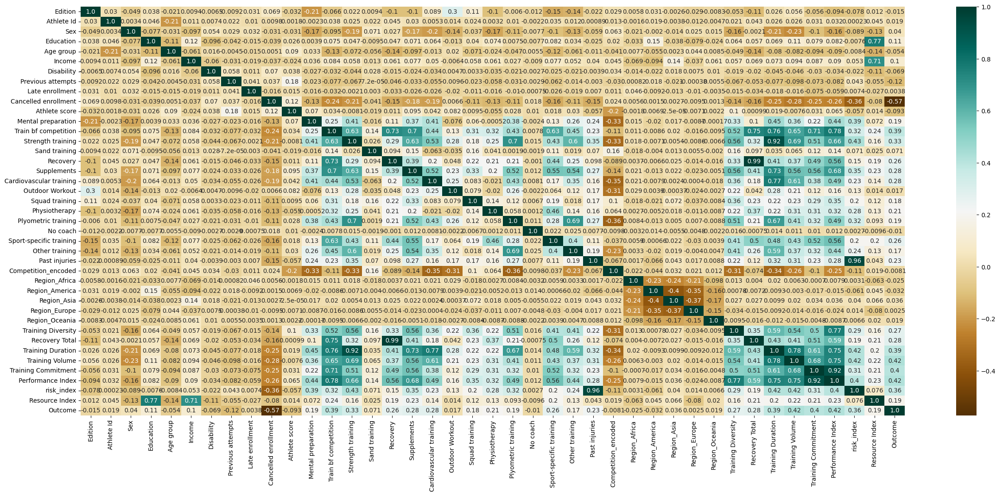

In [ ]:
cor_pearson = pd.concat([x_train, y_train], axis=1).corr(method='pearson')
cor_pearson

#figure
plt.figure(figsize=(30,12))
sns.heatmap(data=cor_pearson, annot=True, cmap = plt.cm.BrBG, fmt='.2')

In [ ]:
"""x_train = x_train.drop(["Strength training", 'Recovery', 'Training Commitment', 'Past injuries'], axis=1)
x_test = x_test.drop(["Strength training", 'Recovery', 'Training Commitment', 'Past injuries'], axis=1)
test = test.drop(["Strength training", 'Recovery', 'Training Commitment','Past injuries'], axis=1)"""

'x_train = x_train.drop(["Strength training", \'Recovery\', \'Training Commitment\', \'Past injuries\'], axis=1)\nx_test = x_test.drop(["Strength training", \'Recovery\', \'Training Commitment\', \'Past injuries\'], axis=1)\ntest = test.drop(["Strength training", \'Recovery\', \'Training Commitment\',\'Past injuries\'], axis=1)'

#### RFC - Gradient Boosting Model

In [ ]:
numeric_variables = x_train.select_dtypes(include=['int', 'float']).columns
numeric_variables

Index(['Edition', 'Athlete Id', 'Sex', 'Education', 'Age group', 'Income',
       'Disability', 'Previous attempts', 'Late enrollment',
       'Cancelled enrollment', 'Athlete score', 'Mental preparation',
       'Train bf competition', 'Strength training', 'Sand training',
       'Recovery', 'Supplements', 'Cardiovascular training', 'Outdoor Workout',
       'Squad training', 'Physiotherapy', 'Plyometric training', 'No coach',
       'Sport-specific training', 'Other training', 'Past injuries',
       'Competition_encoded', 'Region_Africa', 'Region_America', 'Region_Asia',
       'Region_Europe', 'Region_Oceania', 'Training Diversity',
       'Recovery Total', 'Training Duration', 'Training Volume',
       'Training Commitment', 'Performance Index', 'risk_index',
       'Resource Index'],
      dtype='object')

In [ ]:
"""from sklearn.metrics import accuracy_score
from sklearn.feature_selection import RFE
from sklearn.ensemble import GradientBoostingClassifier

# Define the model
model = GradientBoostingClassifier()

# Define the range of number of features to try
nof_list = np.arange(2, 18) 

# Variables to store the optimum features and score
high_score = 0
nof = 0
selected_features = []

# Loop over the number of features
for n in range(len(nof_list)):
    
    # Create an instance of RFE
    rfe = RFE(model, n_features_to_select=nof_list[n])
    
    # Fit RFE to training data
    X_train_rfe = rfe.fit_transform(x_train[numeric_variables], y_train)
    
    # Apply the same RFE transformation to the test data
    X_test_rfe = rfe.transform(x_test[numeric_variables])
    
    # Train the model
    model.fit(X_train_rfe, y_train)
    
    # Make predictions on test data
    y_pred = model.predict(X_test_rfe)
    
    # Compute accuracy score
    accuracy = accuracy_score(y_test, y_pred)
    
    # Store the score
    if accuracy > high_score:
        high_score = accuracy
        nof = nof_list[n]
        selected_features = rfe.support_
        
# Print the results
print("Optimum number of features: %d" % nof)
print("Score with %d features: %f" % (nof, high_score))
print("Selected features:", x_train[numeric_variables].columns[selected_features])"""

'from sklearn.metrics import accuracy_score\nfrom sklearn.feature_selection import RFE\nfrom sklearn.ensemble import GradientBoostingClassifier\n\n# Define the model\nmodel = GradientBoostingClassifier()\n\n# Define the range of number of features to try\nnof_list = np.arange(2, 18) \n\n# Variables to store the optimum features and score\nhigh_score = 0\nnof = 0\nselected_features = []\n\n# Loop over the number of features\nfor n in range(len(nof_list)):\n    \n    # Create an instance of RFE\n    rfe = RFE(model, n_features_to_select=nof_list[n])\n    \n    # Fit RFE to training data\n    X_train_rfe = rfe.fit_transform(x_train[numeric_variables], y_train)\n    \n    # Apply the same RFE transformation to the test data\n    X_test_rfe = rfe.transform(x_test[numeric_variables])\n    \n    # Train the model\n    model.fit(X_train_rfe, y_train)\n    \n    # Make predictions on test data\n    y_pred = model.predict(X_test_rfe)\n    \n    # Compute accuracy score\n    accuracy = accuracy_s

In [ ]:
#top_features = x_train[numeric_variables].columns[selected_features]

#for one of the best result 
top_features = ['Athlete Id', 'Sex', 'Income', 'Previous attempts',
       'Cancelled enrollment', 'Mental preparation', 'Train bf competition',
       'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Past injuries', 'Recovery Total',
       'Competition_encoded', 'Training Duration']

#other selection made by the model training feature selection
top_features_1 = ['Edition', 'Sex', 'Education', 'Cancelled enrollment',
       'Train bf competition', 'Supplements', 'Cardiovascular training',
       'Physiotherapy', 'Competition_encoded', 'Recovery Total',
       'Training Duration', 'Performance Index', 'risk_index']

#other selection made by the model training feature selection
top_features_2 = ['Cancelled enrollment', 'Train bf competition',
       'Cardiovascular training', 'Competition_encoded', 'Recovery Total',
       'Training Duration', 'Performance Index', 'risk_index',
       'Resource Index']

#other selection made by the model training feature selection
top_features_3 = ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts',
       'Cancelled enrollment', 'Mental preparation', 'Train bf competition',
       'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Sport-specific training', 'Past injuries',
       'Recovery Total', 'Competition_encoded', 'Training Duration']

#for one of the best result 
top_features_4 = ['Edition', 'Athlete Id', 'Sex', 'Income', 'Cancelled enrollment',
       'Mental preparation', 'Train bf competition', 'Strength training',
       'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Past injuries', 'Recovery Total',
       'Competition_encoded']

features_list = [top_features,top_features_1,top_features_2,top_features_3, top_features_4]

# <font color='#BFD72F'>**3. MODELING**</font> <a class="anchor" id="import"></a>
[Back to Contents](#toc)

In [ ]:
import warnings
from sklearn.exceptions import DataConversionWarning

# Filter out the DataConversionWarning
warnings.filterwarnings("ignore", category=DataConversionWarning)

In [ ]:
X_train = x_train.copy()
X_test = x_test.copy()
disc = test.copy()

### NAIVE BAYES

In [ ]:
from sklearn.naive_bayes import GaussianNB

best_accuracy = 0
best_features = None

# Train and test the Naive Bayes classifier for each set of features
for features in features_list:
    # Select the corresponding features from the training and test datasets
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    # Create and fit the Naive Bayes classifier
    modelNB = GaussianNB()
    modelNB.fit(X_train_subset, y_train)
    
    # Predict labels for test dataset
    labels_test = modelNB.predict(X_test_subset)
    
    # Calculate the accuracy for test dataset
    accuracy = modelNB.score(X_test_subset, y_test)
    
    # Check if the current feature set has higher accuracy than the previous best
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_features = features

# Print the best feature set and its accuracy
print("Best feature set:", best_features)
print("Accuracy for x_test:", best_accuracy)


Best feature set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Sport-specific training', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Accuracy for x_test: 0.7725838829939776


### KNN Classifier

In [ ]:
best_accuracy = 0.0
best_features = []

for features in features_list:
    X_train_selected = X_train[features]
    X_test_selected = X_test[features]
    
    modelKNN = KNeighborsClassifier()
    modelKNN.fit(X_train_selected, y_train)
    
    train_accuracy = modelKNN.score(X_train_selected, y_train)
    test_accuracy = modelKNN.score(X_test_selected, y_test)
    
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features

print("Best Features:", best_features)
print("Best Test Accuracy:", best_accuracy)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 0.8852106620808254
Test Accuracy: 0.8445655291081159
Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 0.8881484666093437
Test Accuracy: 0.8394034987094924
Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 0.8887933505302379
Test Accuracy: 0.8494407800401491
Features: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Pre

In [ ]:
scores_train = []
scores_test = []
max_depth_list = range(30,100)

for i in max_depth_list:
    DTC = KNeighborsClassifier(n_neighbors=i)
    DTC.fit(X_train[top_features_4], y_train)
    scores_train.append(DTC.score(X_train[top_features_4], y_train))
    scores_test.append(DTC.score(X_test[top_features_4], y_test))

In [ ]:
best_score = max(scores_test)
best_n_neighbors = max_depth_list[scores_test.index(best_score)]
print("Best test score: {:.4f}".format(best_score))
print("Best value of n_neighbors: {}".format(best_n_neighbors))


Best test score: 0.8271
Best value of n_neighbors: 31


In [ ]:
best_accuracy = 0
best_features = None

for features in features_list:
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    modelKNN = KNeighborsClassifier(n_neighbors=best_n_neighbors).fit(X_train_subset, y_train)
    modelKNN.fit(X_train_subset, y_train)
    
    train_accuracy = modelKNN.score(X_train_subset, y_train)
    test_accuracy = modelKNN.score(X_test_subset, y_test)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features
        
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print()
    
print("Best feature set:", best_features)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 0.8509601605044426
Test Accuracy: 0.8471465443074276

Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 0.8452278589853827
Test Accuracy: 0.8365357040435905

Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 0.8604184580108913
Test Accuracy: 0.8554631488385431

Features: ['Edition', 'Athlete Id', 'Sex', 'Income', '

Changing the distance metric to Manhattan__

In [ ]:
best_accuracy = 0
best_features = None

for features in features_list:
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    modelKNNM = KNeighborsClassifier(metric='manhattan')
    modelKNNM.fit(X_train_subset, y_train)
    
    train_accuracy = modelKNNM.score(X_train_subset, y_train)
    test_accuracy = modelKNNM.score(X_test_subset, y_test)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features
        
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print()
    
print("Best feature set:", best_features)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 0.8902264259100029
Test Accuracy: 0.8457126469744767

Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 0.8920177701347091
Test Accuracy: 0.8419845139088041

Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 0.8895098882201203
Test Accuracy: 0.8482936621737883

Features: ['Edition', 'Athlete Id', 'Sex', 'Income', '

Distance Weighted KNN__

In [ ]:
best_accuracy = 0
best_features = None

for features in features_list:
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    modelKNNW = KNeighborsClassifier(weights='distance')
    modelKNNW.fit(X_train_subset, y_train)
    
    train_accuracy = modelKNNW.score(X_train_subset, y_train)
    test_accuracy = modelKNNW.score(X_test_subset, y_test)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features
        
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print()
    
print("Best feature set:", best_features)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 1.0
Test Accuracy: 0.840263837109263

Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 1.0
Test Accuracy: 0.8373960424433611

Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 1.0
Test Accuracy: 0.8488672211069688

Features: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'M

##<h3>Decision Trees</h3>

In [ ]:
best_accuracy = 0
best_features = None

for features in features_list:
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    modelDT = DecisionTreeClassifier()
    modelDT.fit(X_train_subset, y_train)
    
    train_accuracy = modelDT.score(X_train_subset, y_train)
    test_accuracy = modelDT.score(X_test_subset, y_test)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features
        
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print()
    
print("Best feature set:", best_features)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 1.0
Test Accuracy: 0.8158875824490966

Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 1.0
Test Accuracy: 0.788069974189848

Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 1.0
Test Accuracy: 0.7720103240607973

Features: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'M

Changing the criterion for the DT__

In [ ]:
modelDT_entropy = DecisionTreeClassifier(criterion='entropy')
modelDT_entropy.fit(X_train, y_train)
modelDT_entropy_pred = modelDT_entropy.predict(X_test)

print(f'Score for x_train:', modelDT_entropy.score(X_train, y_train))
print(f'Score for x_test:', modelDT_entropy.score(X_test, y_test))

Score for x_train: 1.0
Score for x_test: 0.8035560653857183


Changing Maximum Depth of the Tree__

In [ ]:
scores_train = []
scores_test = []
max_depth_list = range(1,15)

for i in max_depth_list:
    DTC = DecisionTreeClassifier(max_depth=i)
    DTC.fit(X_train[top_features_3], y_train)
    scores_train.append(DTC.score(X_train[top_features_3], y_train))
    scores_test.append(DTC.score(X_test[top_features_3], y_test))

In [ ]:
best_score = max(scores_test)
best_score_index = scores_test.index(best_score)
best_max_depth = max_depth_list[best_score_index]
print(f"The best score is {best_score:.4f} with max_depth = {best_max_depth}")

The best score is 0.8572 with max_depth = 7


In [ ]:
best_accuracy = 0
best_features = None

for features in features_list:
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    modelDT_maxdepth5 = DecisionTreeClassifier(max_depth=best_max_depth)
    modelDT_maxdepth5.fit(X_train_subset, y_train)
    
    train_accuracy = modelDT_maxdepth5.score(X_train_subset, y_train)
    test_accuracy = modelDT_maxdepth5.score(X_test_subset, y_test)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features
        
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print()
    
print("Best feature set:", best_features)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 0.869231871596446
Test Accuracy: 0.855176369371953

Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 0.870091716824305
Test Accuracy: 0.8563234872383138

Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 0.8725995987388937
Test Accuracy: 0.8517350157728707

Features: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Pre

Changing the Number of Leaf Nodes__

In [ ]:
from sklearn.tree import DecisionTreeClassifier

max_leaf_nodes_list = range(5, 30)

for features in features_list:
    scores_train = []
    scores_test = []
    print("Current feature set:", features)
    print("-----------------------------")
    
    for i in max_leaf_nodes_list:
        DTC = DecisionTreeClassifier(max_leaf_nodes=i)
        DTC.fit(X_train[features], y_train)
        scores_train.append(DTC.score(X_train[features], y_train))
        scores_test.append(DTC.score(X_test[features], y_test))

    # Print the scores
    for i, max_leaf_nodes in enumerate(max_leaf_nodes_list):
        print("Max Leaf Nodes:", max_leaf_nodes)
        print("Train Accuracy:", scores_train[i])
        print("Test Accuracy:", scores_test[i])
        print()


Current feature set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
-----------------------------
Max Leaf Nodes: 5
Train Accuracy: 0.8357695614789338
Test Accuracy: 0.8224835101806711

Max Leaf Nodes: 6
Train Accuracy: 0.8417168243049584
Test Accuracy: 0.8276455405792945

Max Leaf Nodes: 7
Train Accuracy: 0.8417168243049584
Test Accuracy: 0.8276455405792945

Max Leaf Nodes: 8
Train Accuracy: 0.8417168243049584
Test Accuracy: 0.8276455405792945

Max Leaf Nodes: 9
Train Accuracy: 0.8526081971911722
Test Accuracy: 0.8382563808431316

Max Leaf Nodes: 10
Train Accuracy: 0.853683003725996
Test Accuracy: 0.8371092629767709

Max Leaf Nodes: 11
Train Accuracy: 0.853683003725996
Test Accuracy: 0.8371092629767709

Max Leaf Nodes: 12
Train Accuracy: 0.8567641157924907


In [ ]:
best_score = max(scores_test)
best_max_leaf_nodes = max_leaf_nodes_list[scores_test.index(best_score)]

print("Best score:", best_score)
print("Best max_leaf_nodes:", best_max_leaf_nodes)

Best score: 0.8609119587037568
Best max_leaf_nodes: 25


In [ ]:
best_accuracy = 0
best_features = None

for features in features_list:
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    modelDT_leafs13 = DecisionTreeClassifier(max_leaf_nodes=best_max_leaf_nodes)
    modelDT_leafs13.fit(X_train_subset, y_train)
    
    train_accuracy = modelDT_leafs13.score(X_train_subset, y_train)
    test_accuracy = modelDT_leafs13.score(X_test_subset, y_test)
    
    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_features = features
        
    print("Features:", features)
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print()
    
print("Best feature set:", best_features)

Features: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Train Accuracy: 0.8657208369160218
Test Accuracy: 0.8511614568396902

Features: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Train Accuracy: 0.8699484092863284
Test Accuracy: 0.8560367077717236

Features: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Train Accuracy: 0.8704499856692463
Test Accuracy: 0.8554631488385431

Features: ['Edition', 'Athlete Id', 'Sex', 'Income', '

##Bagging* over KNN__

In [ ]:
from sklearn.ensemble import BaggingClassifier

bagging_scores_train = []
bagging_scores_test = []

for features in features_list:
    print("Current feature set:", features)
    print("-----------------------------")

    # Train the BaggingClassifier with the base estimator modelKNN100
    bagging_KNN100 = BaggingClassifier(base_estimator=modelKNN)
    bagging_KNN100.fit(X_train[features], y_train)

    # Evaluate the model on train and test data
    train_score = bagging_KNN100.score(X_train[features], y_train)
    test_score = bagging_KNN100.score(X_test[features], y_test)

    # Append the scores to the respective lists
    bagging_scores_train.append(train_score)
    bagging_scores_test.append(test_score)

    print("Train Accuracy:", train_score)
    print("Test Accuracy:", test_score)
    print()

# Find the index of the best performing feature set
best_feature_index = np.argmax(bagging_scores_test)
best_features = features_list[best_feature_index]

print("Best feature set:", best_features)


Current feature set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.8520349670392663
Test Accuracy: 0.8488672211069688

Current feature set: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.8462310117512181
Test Accuracy: 0.8371092629767709

Current feature set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.8601318429349384
Test Accuracy: 0.8546028104387726

Current feature set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Sport-specific training', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.8351963313270278
Test Accuracy: 0.8287926584456553

Current feature set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Strength training', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.8336916021782745
Test Accuracy: 0.8279323200458847

Best feature set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']


##__Bagging over Decision Trees__

In [ ]:
from sklearn.ensemble import BaggingClassifier

bagging_scores_train = []
bagging_scores_test = []

for features in features_list:
    print("Current feature set:", features)
    print("-----------------------------")

    # Train the BaggingClassifier with the base estimator modelKNN100
    bagging_DT = BaggingClassifier(base_estimator=modelDT)
    bagging_DT.fit(X_train[features], y_train)

    # Evaluate the model on train and test data
    train_score = bagging_DT.score(X_train[features], y_train)
    test_score = bagging_DT.score(X_test[features], y_test)

    # Append the scores to the respective lists
    bagging_scores_train.append(train_score)
    bagging_scores_test.append(test_score)

    print("Train Accuracy:", train_score)
    print("Test Accuracy:", test_score)
    print()

# Find the index of the best performing feature set
best_feature_index = np.argmax(bagging_scores_test)
best_features = features_list[best_feature_index]

print("Best feature set:", best_features)


Current feature set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.9932645457151046
Test Accuracy: 0.8485804416403786

Current feature set: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.9931928919461164
Test Accuracy: 0.8517350157728707

Current feature set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.9903267411865864
Test Accuracy: 0.83567536564382

Current feature set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Sport-specific training', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.9929779306391516
Test Accuracy: 0.852308574706051

Current feature set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Strength training', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded']
-----------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Train Accuracy: 0.9923330467182574
Test Accuracy: 0.8482936621737883

Best feature set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Sport-specific training', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']


Changing the number of estimators__

In [ ]:
from sklearn.ensemble import BaggingClassifier

scores_train = []
scores_test = []
estimators = [5, 10, 15, 20, 25, 30, 35, 40]

for estimator in estimators:
    # Train the BaggingClassifier with the base estimator modelDT and different number of estimators
    bagging_DT = BaggingClassifier(base_estimator=modelDT, n_estimators=estimator, random_state=5)
    bagging_DT.fit(X_train, y_train)

    # Calculate and store the train and test accuracy scores
    train_score = bagging_DT.score(X_train, y_train)
    test_score = bagging_DT.score(X_test, y_test)
    scores_train.append(train_score)
    scores_test.append(test_score)

    print("Number of Estimators:", estimator)
    print("Train Accuracy:", train_score)
    print("Test Accuracy:", test_score)
    print()

# Find the index of the best accuracy score (validation)
best_score = max(scores_test)
best_index = scores_test.index(best_score)
best_estimator = estimators[best_index]

print("Best accuracy score (validation): {0:.3f}".format(best_score))
print("Best number of estimators:", best_estimator)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 5
Train Accuracy: 0.9805101748351963
Test Accuracy: 0.8459994264410668



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 10
Train Accuracy: 0.9931928919461164
Test Accuracy: 0.846286205907657



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 15
Train Accuracy: 0.9950558899398109
Test Accuracy: 0.8577573845712647



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 20
Train Accuracy: 0.9978503869303526
Test Accuracy: 0.8577573845712647



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 25
Train Accuracy: 0.9987818859271997
Test Accuracy: 0.8643533123028391



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 30
Train Accuracy: 0.9994984236170823
Test Accuracy: 0.8652136507026097



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 35
Train Accuracy: 0.9994984236170823
Test Accuracy: 0.8675078864353313



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Number of Estimators: 40
Train Accuracy: 0.9996417311550587
Test Accuracy: 0.8683682248351018

Best accuracy score (validation): 0.868
Best number of estimators: 40


In [ ]:
bagging_DT_40 = BaggingClassifier(base_estimator = modelDT, n_estimators = best_estimator, random_state = 5)
bagging_DT_40.fit(X = X_train[top_features_3], y = y_train)
print(bagging_DT_40.score(X_train[top_features_3], y_train))
print(bagging_DT_40.score(X_test[top_features_3], y_test))
bagging_DT_40_pred = bagging_DT_40.predict(X_test[top_features_3])

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


0.999426769848094
0.8620590765701176


Changing the number of samples__

In [ ]:
from sklearn.ensemble import BaggingClassifier

scores_train = []
scores_test = []
max_samples_list = [0.3, 0.4, 0.5, 0.6, 0.7, 0.8]

for max_samples in max_samples_list:
    # Train the BaggingClassifier with the base estimator modelDT and different maximum number of samples
    bagging_DT = BaggingClassifier(base_estimator=modelDT, max_samples=max_samples, random_state=5)
    bagging_DT.fit(X_train, y_train)

    # Calculate and store the train and test accuracy scores
    train_score = bagging_DT.score(X_train, y_train)
    test_score = bagging_DT.score(X_test, y_test)
    scores_train.append(train_score)
    scores_test.append(test_score)

    print("Maximum Number of Samples:", max_samples)
    print("Train Accuracy:", train_score)
    print("Test Accuracy:", test_score)
    print()

# Find the index of the best accuracy score (validation)
best_score = max(scores_test)
best_index = scores_test.index(best_score)
best_max_samples = max_samples_list[best_index]

print("Best accuracy score (validation): {0:.3f}".format(best_score))
print("Best maximum number of samples:", best_max_samples)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Maximum Number of Samples: 0.3
Train Accuracy: 0.9216824304958441
Test Accuracy: 0.8488672211069688



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Maximum Number of Samples: 0.4
Train Accuracy: 0.9422470621954715
Test Accuracy: 0.8514482363062804



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Maximum Number of Samples: 0.5
Train Accuracy: 0.9589423903697335
Test Accuracy: 0.8482936621737883



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Maximum Number of Samples: 0.6
Train Accuracy: 0.9696904557179707
Test Accuracy: 0.847720103240608



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Maximum Number of Samples: 0.7
Train Accuracy: 0.9792204069934078
Test Accuracy: 0.8557499283051333



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Maximum Number of Samples: 0.8
Train Accuracy: 0.9856692462023502
Test Accuracy: 0.8471465443074276

Best accuracy score (validation): 0.856
Best maximum number of samples: 0.7


##Gradient Boosting

In [ ]:
"""from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

# Define the parameter grid with the hyperparameter combinations to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.1, 0.01, 0.001],
    'max_depth': [3, 5, 7]
}

# Create the model to be tuned
model = GradientBoostingClassifier(random_state=42)

# Perform grid search
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding performance
print("Best Hyperparameters: ", grid_search.best_params_)
print("Best Score: ", grid_search.best_score_)

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
accuracy = best_model.score(X_test, y_test)
print("Test Set Accuracy: ", accuracy)"""

'from sklearn.ensemble import GradientBoostingClassifier\nfrom sklearn.model_selection import GridSearchCV\n\n# Define the parameter grid with the hyperparameter combinations to search\nparam_grid = {\n    \'n_estimators\': [100, 200, 300],\n    \'learning_rate\': [0.1, 0.01, 0.001],\n    \'max_depth\': [3, 5, 7]\n}\n\n# Create the model to be tuned\nmodel = GradientBoostingClassifier(random_state=42)\n\n# Perform grid search\ngrid_search = GridSearchCV(model, param_grid, cv=5, scoring=\'accuracy\')\ngrid_search.fit(X_train, y_train)\n\n# Print the best hyperparameters and the corresponding performance\nprint("Best Hyperparameters: ", grid_search.best_params_)\nprint("Best Score: ", grid_search.best_score_)\n\n# Get the best model\nbest_model = grid_search.best_estimator_\n\n# Evaluate the best model on the test set\naccuracy = best_model.score(X_test, y_test)\nprint("Test Set Accuracy: ", accuracy)'

For GB:
* Best Hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
* Best Score:  0.876331336724879
* Test Set Accuracy:  0.8665183537263627

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

# Initialize variables to store the best accuracy and feature set
best_accuracy = 0.0
best_features = None

# Iterate over the feature sets
for features in features_list:
    # Select the features from the dataset
    X_train_selected = X_train[features]
    X_test_selected = X_test[features]

    # Train a Gradient Boosting model using the selected features
    model_GB = GradientBoostingClassifier(n_estimators=300, random_state=42)
    model_GB.fit(X_train_selected, y_train)

    # Generate predictions using the Gradient Boosting model on the testing data
    GB_predictions = model_GB.predict(X_test_selected)

    # Evaluate the accuracy of the Gradient Boosting model
    accuracy = accuracy_score(y_test, GB_predictions)

    # Check if the current accuracy is better than the best accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_features = features

    print("Feature Set:", features)
    print("Accuracy:", accuracy)
    print()

# Print the best feature set and its corresponding accuracy
print("Best Feature Set:", best_features)
print("Best Accuracy:", best_accuracy)


Feature Set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Accuracy: 0.8632061944364784

Feature Set: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Accuracy: 0.8698021221680527

Feature Set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Accuracy: 0.8632061944364784

Feature Set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Ca

RFC:
* Best Hyperparameters:  {'max_depth': None, 'min_samples_split': 5, 'n_estimators': 300}
* Best Score:  0.8777928841485082
* Test Set Accuracy:  0.8670745272525028

## Bagging over Gradient Boosting

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

# Initialize variables to store the best accuracy and feature set
best_accuracy = 0.0
best_features = None

# Iterate over the feature sets
for features in features_list:
    # Select the features from the dataset
    X_train_selected = X_train[features]
    X_test_selected = X_test[features]

    # Create a Bagging Classifier with a base estimator of Gradient Boosting
    bagging_GB = BaggingClassifier(base_estimator=model_GB)
    bagging_GB.fit(X_train_selected, y_train)

    # Generate predictions using the Bagging Classifier on the testing data
    bagging_GB_predictions = bagging_GB.predict(X_test_selected)

    # Evaluate the accuracy of the Bagging Classifier
    accuracy = accuracy_score(y_test, bagging_GB_predictions)

    # Check if the current accuracy is better than the best accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_features = features

    print("Feature Set:", features)
    print("Accuracy:", accuracy)
    print()

# Print the best feature set and its corresponding accuracy
print("Best Feature Set:", best_features)
print("Best Accuracy:", best_accuracy)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Feature Set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Accuracy: 0.8512366186784791



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Feature Set: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Accuracy: 0.8493909191583611



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Feature Set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Accuracy: 0.8541897379106681



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Feature Set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Sport-specific training', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Accuracy: 0.8519748984865264



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Feature Set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Strength training', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded']
Accuracy: 0.8527131782945736

Best Feature Set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Best Accuracy: 0.8541897379106681


##NN

In [ ]:
"""scores_train = []
scores_test = []
solvers= ['lbfgs','sgd','adam']
learning_rates = [0.01, 0.05, 0.1,0.2, 0.25,0.3,0.35,0.4, 0.5, 0.75, 1]

for solver in solvers:
    for learning_rate in learning_rates:
        modelNN = MLPClassifier(solver=solver, learning_rate_init=learning_rate)
        modelNN.fit(X_train, y_train)
        score_train = modelNN.score(X_train, y_train)
        score_test = modelNN.score(X_test, y_test)
        scores_train.append(score_train)
        scores_test.append(score_test)

best_score = max(scores_test)
best_index = scores_test.index(best_score)
best_solver = solvers[best_index // len(learning_rates)]
best_lr = learning_rates[best_index % len(learning_rates)]

print("Best combination: solver = {}, learning rate = {}".format(best_solver, best_lr))
print("Accuracy score (training): {0:.3f}".format(scores_train[best_index]))
print("Accuracy score (validation): {0:.3f}".format(best_score))
"""

'scores_train = []\nscores_test = []\nsolvers= [\'lbfgs\',\'sgd\',\'adam\']\nlearning_rates = [0.01, 0.05, 0.1,0.2, 0.25,0.3,0.35,0.4, 0.5, 0.75, 1]\n\nfor solver in solvers:\n    for learning_rate in learning_rates:\n        modelNN = MLPClassifier(solver=solver, learning_rate_init=learning_rate)\n        modelNN.fit(X_train, y_train)\n        score_train = modelNN.score(X_train, y_train)\n        score_test = modelNN.score(X_test, y_test)\n        scores_train.append(score_train)\n        scores_test.append(score_test)\n\nbest_score = max(scores_test)\nbest_index = scores_test.index(best_score)\nbest_solver = solvers[best_index // len(learning_rates)]\nbest_lr = learning_rates[best_index % len(learning_rates)]\n\nprint("Best combination: solver = {}, learning rate = {}".format(best_solver, best_lr))\nprint("Accuracy score (training): {0:.3f}".format(scores_train[best_index]))\nprint("Accuracy score (validation): {0:.3f}".format(best_score))\n'

Best combination: solver = adam, learning rate = 0.01

In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

for features in features_list:
    # Select the subset of features
    X_train_subset = X_train[features]
    X_test_subset = X_test[features]
    
    # Train an MLP classifier
    modelNN = MLPClassifier(solver="adam", learning_rate_init=0.01)
    modelNN.fit(X_train_subset, y_train)
    
    # Generate predictions using the trained model
    modelNN_pred = modelNN.predict(X_test_subset)
    
    # Calculate the accuracy of the model
    accuracy = accuracy_score(y_test, modelNN_pred)
    print("Feature Set:", features)
    print("Accuracy:", accuracy)
    print()


Feature Set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Accuracy: 0.8464377999261721

Feature Set: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Accuracy: 0.8482834994462901

Feature Set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Accuracy: 0.8475452196382429

Feature Set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Ca

## Random Forest Classifier and Gradient Boosting ensemble

In [ ]:
"""from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

# Define the parameter grid with the hyperparameter combinations to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10]
}

# Create the model to be tuned
model = RandomForestClassifier(random_state=42)

# Perform grid search
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding performance
print("Best Hyperparameters: ", grid_search.best_params_)
print("Best Score: ", grid_search.best_score_)

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
accuracy = best_model.score(X_test, y_test)
print("Test Set Accuracy: ", accuracy)"""


'from sklearn.ensemble import RandomForestClassifier\nfrom sklearn.model_selection import GridSearchCV\n\n# Define the parameter grid with the hyperparameter combinations to search\nparam_grid = {\n    \'n_estimators\': [100, 200, 300],\n    \'max_depth\': [None, 5, 10],\n    \'min_samples_split\': [2, 5, 10]\n}\n\n# Create the model to be tuned\nmodel = RandomForestClassifier(random_state=42)\n\n# Perform grid search\ngrid_search = GridSearchCV(model, param_grid, cv=5, scoring=\'accuracy\')\ngrid_search.fit(X_train, y_train)\n\n# Print the best hyperparameters and the corresponding performance\nprint("Best Hyperparameters: ", grid_search.best_params_)\nprint("Best Score: ", grid_search.best_score_)\n\n# Get the best model\nbest_model = grid_search.best_estimator_\n\n# Evaluate the best model on the test set\naccuracy = best_model.score(X_test, y_test)\nprint("Test Set Accuracy: ", accuracy)'

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, f1_score



# Initialize variables to store the best accuracy and feature set
best_accuracy = 0.0
best_features = None

# Iterate over the feature sets
for features in features_list:
    # Select the features from the dataset
    X_train_selected = X_train[features]
    X_test_selected = X_test[features]

    # Train a Random Forest model
    rf_model = RandomForestClassifier(n_estimators=300, max_depth=None, min_samples_split=5, random_state=42)
    rf_model.fit(X_train_selected, y_train)

    # Generate predictions using the Random Forest model for both training and testing data
    rf_train_predictions = rf_model.predict(X_train_selected)
    rf_test_predictions = rf_model.predict(X_test_selected)

    # Combine the Random Forest predictions with the original features for both training and testing data
    combined_train_features = np.column_stack((X_train_selected, rf_train_predictions))
    combined_test_features = np.column_stack((X_test_selected, rf_test_predictions))

    # Train a Gradient Boosting model using the combined features
    gb_model = GradientBoostingClassifier(n_estimators=200, learning_rate=0.1, max_depth=5, random_state=42)
    gb_model.fit(combined_train_features, y_train)

    # Generate predictions using the Gradient Boosting model on the testing data
    gb_predictions = gb_model.predict(combined_test_features)

    # Evaluate the accuracy of the Gradient Boosting model
    accuracy = accuracy_score(y_test, gb_predictions)

    # Check if the current accuracy is better than the best accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_features = features

    print("Feature Set:", features)
    print("Accuracy:", accuracy)
    print()

# Print the best feature set and its corresponding accuracy
print("Best Feature Set:", best_features)
print("Best Accuracy:", best_accuracy)


Feature Set: ['Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Past injuries', 'Recovery Total', 'Competition_encoded', 'Training Duration']
Accuracy: 0.8523440383905501

Feature Set: ['Edition', 'Sex', 'Education', 'Cancelled enrollment', 'Train bf competition', 'Supplements', 'Cardiovascular training', 'Physiotherapy', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index']
Accuracy: 0.8512366186784791

Feature Set: ['Cancelled enrollment', 'Train bf competition', 'Cardiovascular training', 'Competition_encoded', 'Recovery Total', 'Training Duration', 'Performance Index', 'risk_index', 'Resource Index']
Accuracy: 0.8471760797342193

Feature Set: ['Edition', 'Athlete Id', 'Sex', 'Income', 'Previous attempts', 'Cancelled enrollment', 'Mental preparation', 'Train bf competition', 'Supplements', 'Ca

* ZSCORE E RANDOM = 0.8659621802002224
* MAD E RANDOM =    0.8577623590633131
* MAHALA E RANDOM = 0.8612315698178664
* ZSCORE E MEDIAN = 0.8667
* Sem remoção outliers = 0.8692
* Atrás training set é 0.7 = 0.8717 mas resultado fina não melhora

# 4. EVALUATION

## Best feature selection result - Top_features_4

['Edition', 'Athlete Id', 'Sex', 'Income', 'Cancelled enrollment',
       'Mental preparation', 'Train bf competition', 'Strength training',
       'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Past injuries', 'Recovery Total',
       'Competition_encoded']

In [ ]:
import pandas as pd
X_test = x_test[top_features_4].copy()
X_train = x_train[top_features_4].copy()
disc = test[top_features_4].copy()

# Train Decision Tree model
modelDT = DecisionTreeClassifier()
modelDT.fit(X_train, y_train)

# Train Bagging Decision Tree model
bagging_DT = BaggingClassifier(base_estimator=modelDT)
bagging_DT.fit(X_train, y_train)

# Train Bagging Decision Tree with 40 estimators model
bagging_DT_40 = BaggingClassifier(base_estimator = modelDT, n_estimators = best_estimator, random_state = 5)
bagging_DT_40.fit(X_train, y_train)

# Train Decision Tree with max_leaf_nodes=13 model
modelDT_leafs13 = DecisionTreeClassifier(max_leaf_nodes=13)
modelDT_leafs13.fit(X_train, y_train)

# Train Decision Tree with max_depth=5 model
modelDT_maxdepth5 = DecisionTreeClassifier(max_depth=5)
modelDT_maxdepth5.fit(X_train, y_train)

# Train KNN with weights='distance' model
modelKNNW = KNeighborsClassifier(weights='distance')
modelKNNW.fit(X_train, y_train)

# Train KNN with metric='manhattan' model
modelKNNM = KNeighborsClassifier(metric='manhattan')
modelKNNM.fit(X_train, y_train)

# Train KNN model
modelKNN = KNeighborsClassifier()
modelKNN.fit(X_train, y_train)

# Train Gaussian Naive Bayes model
modelNB = GaussianNB()
modelNB.fit(X_train, y_train)

# Train Gradient Boosting model
model_GB = GradientBoostingClassifier(n_estimators=300, random_state=42)
model_GB.fit(X_train, y_train)

# Train MLP Neural Network model
modelNN = MLPClassifier(solver='adam', learning_rate_init=0.01)
modelNN.fit(X_train, y_train)

# Train Bagging KNN with 100 estimators model
bagging_KNN100 = BaggingClassifier(base_estimator=modelKNN)
bagging_KNN100.fit(X_train, y_train)

# Train Bagging Gradient Boosting model
bagging_GD = BaggingClassifier(base_estimator=model_GB)
bagging_GD.fit(X_train, y_train)

# Train Gradient Boosting with combined features model
# Train a Random Forest model
rf_model = RandomForestClassifier(n_estimators=300, max_depth=None, min_samples_split=5, random_state=42)
rf_model.fit(X_train, y_train)

# Generate predictions using the Random Forest model for both training and testing data
rf_train_predictions = rf_model.predict(X_train)
rf_test_predictions = rf_model.predict(X_test)
rf_disc_predictions = rf_model.predict(disc)

# Combine the Random Forest predictions with the original features for both training and testing data
combined_train_features = np.column_stack((X_train, rf_train_predictions))
combined_test_features = np.column_stack((X_test, rf_test_predictions))
combined_disc_features = np.column_stack((disc, rf_disc_predictions))

# Train a Gradient Boosting model using the combined features
gb_model = GradientBoostingClassifier(n_estimators=200, learning_rate=0.1, max_depth=5, random_state=42)
gb_model.fit(combined_train_features, y_train)

# Train Random Forest model
rf_model = RandomForestClassifier(n_estimators=300, max_depth=None, min_samples_split=5, random_state=42)
rf_model.fit(X_train, y_train)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier(min_samples_split=5, n_estimators=300, random_state=42)

In [ ]:
accuracies = [modelDT.score(X_test, y_test), bagging_DT.score(X_test, y_test), bagging_DT_40.score(X_test, y_test), 
             modelDT_leafs13.score(X_test, y_test), modelDT_maxdepth5.score(X_test, y_test),modelKNNW.score(X_test, y_test),
             modelKNNM.score(X_test, y_test),
             modelKNN.score(X_test, y_test), modelNB.score(X_test, y_test), model_GB.score(X_test, y_test), modelNN.score(X_test, y_test),
             bagging_KNN100.score(X_test, y_test), bagging_GD.score(X_test, y_test), gb_model.score(combined_test_features, y_test), rf_model.score(X_test, y_test)]

train_accuracies = [modelDT.score(X_train, y_train), bagging_DT.score(X_train, y_train), bagging_DT_40.score(X_train, y_train), 
             modelDT_leafs13.score(X_train, y_train), modelDT_maxdepth5.score(X_train, y_train),modelKNNW.score(X_train, y_train),
             modelKNNM.score(X_train, y_train), modelKNN.score(X_train, y_train),modelNB.score(X_train, y_train), model_GB.score(X_train, y_train), modelNN.score(X_train, y_train), 
             bagging_KNN100.score(X_train, y_train), bagging_GD.score(X_train, y_train), gb_model.score(combined_train_features, y_train), rf_model.score(X_train, y_train)]

models = ['DT', 'BG_DT', 'BG_DT_40', 'DT_LEAFS', 'DT_MAX5','KNN W','KNN M','KNN100','KNN', 'NB', 'GB','NN','BG_KNN100','BG_GB','RFC_GB', 'RF']

Evaluation_tuples = list(zip(models,accuracies,train_accuracies))
Evaluation = pd.DataFrame(Evaluation_tuples, columns=['Model', 'Test Accuracy', 'Train Accuracy'])
Evaluation = Evaluation.sort_values('Test Accuracy', ascending=False)


In [ ]:
Evaluation

,Model,Test Accuracy,Train Accuracy
14,RFC_GB,0.872611,0.989407
13,BG_GB,0.871227,0.998546
12,BG_KNN100,0.869011,0.889574
9,NB,0.866242,0.890889
10,GB,0.864304,0.885766
2,BG_DT_40,0.856826,0.998615
3,DT_LEAFS,0.845749,0.859388
1,BG_DT,0.845195,0.992384
4,DT_MAX5,0.840210,0.854126
5,KNN W,0.834672,1.000000


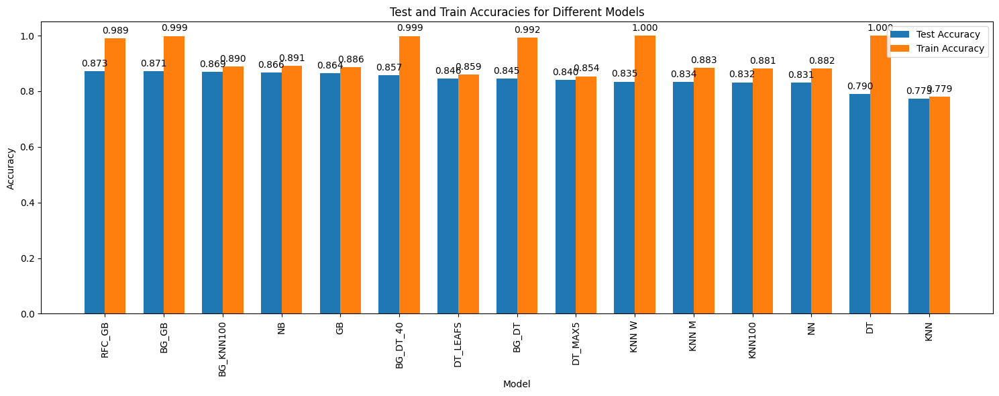

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Sort the Evaluation dataframe by test accuracy
Evaluation_sorted = Evaluation.sort_values('Test Accuracy', ascending=False)

# Set the width of the bars
bar_width = 0.35

# Create the x-axis positions for the bars
x = np.arange(len(Evaluation_sorted))

# Create a bar plot to visualize test and train accuracies
fig, ax = plt.subplots(figsize=(15, 6))
rects1 = ax.bar(x - bar_width/2, Evaluation_sorted['Test Accuracy'], bar_width, label='Test Accuracy')
rects2 = ax.bar(x + bar_width/2, Evaluation_sorted['Train Accuracy'], bar_width, label='Train Accuracy')

# Add labels, title, and legend
ax.set_xlabel('Model')
ax.set_ylabel('Accuracy')
ax.set_title('Test and Train Accuracies for Different Models')
ax.set_xticks(x)
ax.set_xticklabels(Evaluation_sorted['Model'], rotation=90)
ax.legend()

# Add value labels to the bars
def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{:.3f}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

plt.tight_layout()
plt.show()


In [ ]:
top_models = Evaluation.nlargest(3, 'Test Accuracy')
top_model_names = top_models['Model'].tolist()

print("Top 3 models based on test accuracy:")
for model_name in top_model_names:
    print(model_name)


Top 3 models based on test accuracy:
RFC_GB
BG_GB
BG_KNN100


In [ ]:
#Define classification

def print_classification(y_test, y_pred):
    # Classification Report
    print(classification_report(y_test, y_pred))
    
    # Plot
    cm = confusion_matrix(y_test, y_pred)

    plt.figure(figsize = (5,3))
    ax = sns.heatmap(cm, annot=True, fmt='g', cmap = 'Greens')
    ax.set_xlabel('Predicted labels')
    ax.set_ylabel('True labels')
    ax.set_title('Confusion Matrix')
    plt.show()

In [ ]:
modelNN_pred = modelNN.predict(X_test)
gb_predictions = gb_model.predict(combined_test_features)
GB_predictions = model_GB.predict(X_test)
bagging_GD_pred = bagging_GD.predict(X_test)
bagging_KNN100_pred = bagging_KNN100.predict(X_test)

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# create a list of models to compare
models = [(modelNN_pred, modelNN, 'Neural Networks'), (gb_predictions, gb_model, "RFC-Gradient Bosting Ensemble"), (GB_predictions, model_GB, "Gradient Boosting"), (bagging_GD_pred, bagging_GD, "bagging GD"), (bagging_KNN100_pred, bagging_KNN100, "BG_KNN") ]

# create lists to store evaluation scores and metrics
accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
fp_sum_list = []  # List to store the sum of false positives for each model
fn_sum_list = []  # List to store the sum of false negatives for each model

# loop through each model and evaluate its performance
for model_pred, model, model_name in models:
    y_pred = model_pred  # use the provided predictions directly

    # Calculate evaluation metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()

    # Calculate sum of false positives and false negatives
    fp_sum = fp + fn
    fn_sum = fn + fp

    # Store evaluation scores and metrics
    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    fp_sum_list.append(fp_sum)
    fn_sum_list.append(fn_sum)

    # Print evaluation metrics
    print(f"{model_name}:")
    print(f"  Accuracy={accuracy:.3f}, Precision={precision:.3f}, Recall={recall:.3f}, F1={f1:.3f}")
    print(f"  True Positives: {tp}, True Negatives: {tn}, False Positives: {fp}, False Negatives: {fn}")
    print(f"  Sum of Falses: {fp_sum}")
    print()

# Find the best model based on the F1 score
best_model_index = np.argmax(f1_scores)
best_model_pred, best_model, best_model_name = models[best_model_index]
best_f1_score = f1_scores[best_model_index]
best_fp_sum = fp_sum_list[best_model_index]
best_fn_sum = fn_sum_list[best_model_index]


Neural Networks:
  Accuracy=0.864, Precision=0.848, Recall=0.941, F1=0.892
  True Positives: 2026, True Negatives: 1095, False Positives: 363, False Negatives: 127
  Sum of Falses: 490

RFC-Gradient Bosting Ensemble:
  Accuracy=0.871, Precision=0.841, Recall=0.967, F1=0.900
  True Positives: 2081, True Negatives: 1065, False Positives: 393, False Negatives: 72
  Sum of Falses: 465

Gradient Boosting:
  Accuracy=0.866, Precision=0.838, Recall=0.961, F1=0.896
  True Positives: 2070, True Negatives: 1058, False Positives: 400, False Negatives: 83
  Sum of Falses: 483

bagging GD:
  Accuracy=0.869, Precision=0.839, Recall=0.965, F1=0.898
  True Positives: 2078, True Negatives: 1060, False Positives: 398, False Negatives: 75
  Sum of Falses: 473

BG_KNN:
  Accuracy=0.831, Precision=0.823, Recall=0.912, F1=0.866
  True Positives: 1964, True Negatives: 1037, False Positives: 421, False Negatives: 189
  Sum of Falses: 610



## Other best feature selection result - Top_features

['Athlete Id', 'Sex', 'Income', 'Previous attempts',
       'Cancelled enrollment', 'Mental preparation', 'Train bf competition',
       'Supplements', 'Cardiovascular training', 'Squad training',
       'Physiotherapy', 'Past injuries', 'Recovery Total',
       'Competition_encoded', 'Training Duration']

In [ ]:
import pandas as pd
X_test = x_test[top_features].copy()
X_train = x_train[top_features].copy()
disc = test[top_features].copy()

# Train Decision Tree model
modelDT = DecisionTreeClassifier()
modelDT.fit(X_train, y_train)

# Train Bagging Decision Tree model
bagging_DT = BaggingClassifier(base_estimator=modelDT)
bagging_DT.fit(X_train, y_train)

# Train Bagging Decision Tree with 40 estimators model
bagging_DT_40 = BaggingClassifier(base_estimator = modelDT, n_estimators = best_estimator, random_state = 5)
bagging_DT_40.fit(X_train, y_train)

# Train Decision Tree with max_leaf_nodes=13 model
modelDT_leafs13 = DecisionTreeClassifier(max_leaf_nodes=13)
modelDT_leafs13.fit(X_train, y_train)

# Train Decision Tree with max_depth=5 model
modelDT_maxdepth5 = DecisionTreeClassifier(max_depth=5)
modelDT_maxdepth5.fit(X_train, y_train)

# Train KNN with weights='distance' model
modelKNNW = KNeighborsClassifier(weights='distance')
modelKNNW.fit(X_train, y_train)

# Train KNN with metric='manhattan' model
modelKNNM = KNeighborsClassifier(metric='manhattan')
modelKNNM.fit(X_train, y_train)

# Train KNN model
modelKNN = KNeighborsClassifier()
modelKNN.fit(X_train, y_train)

# Train Gaussian Naive Bayes model
modelNB = GaussianNB()
modelNB.fit(X_train, y_train)

# Train Gradient Boosting model
model_GB = GradientBoostingClassifier(n_estimators=300, random_state=42)
model_GB.fit(X_train, y_train)

# Train MLP Neural Network model
modelNN = MLPClassifier(solver='adam', learning_rate_init=0.01)
modelNN.fit(X_train, y_train)

# Train Bagging KNN with 100 estimators model
bagging_KNN100 = BaggingClassifier(base_estimator=modelKNN)
bagging_KNN100.fit(X_train, y_train)

# Train Bagging Gradient Boosting model
bagging_GD = BaggingClassifier(base_estimator=model_GB)
bagging_GD.fit(X_train, y_train)

# Train Gradient Boosting with combined features model
# Train a Random Forest model
rf_model = RandomForestClassifier(n_estimators=300, max_depth=None, min_samples_split=5, random_state=42)
rf_model.fit(X_train, y_train)

# Generate predictions using the Random Forest model for both training and testing data
rf_train_predictions = rf_model.predict(X_train)
rf_test_predictions = rf_model.predict(X_test)
rf_disc_predictions = rf_model.predict(disc)

# Combine the Random Forest predictions with the original features for both training and testing data
combined_train_features = np.column_stack((X_train, rf_train_predictions))
combined_test_features = np.column_stack((X_test, rf_test_predictions))
combined_disc_features = np.column_stack((disc, rf_disc_predictions))

# Train a Gradient Boosting model using the combined features
gb_model = GradientBoostingClassifier(n_estimators=200, learning_rate=0.1, max_depth=5, random_state=42)
gb_model.fit(combined_train_features, y_train)

# Train Random Forest model
rf_model = RandomForestClassifier(n_estimators=300, max_depth=None, min_samples_split=5, random_state=42)
rf_model.fit(X_train, y_train)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier(min_samples_split=5, n_estimators=300, random_state=42)

In [ ]:
accuracies = [modelDT.score(X_test, y_test), bagging_DT.score(X_test, y_test), bagging_DT_40.score(X_test, y_test), 
             modelDT_leafs13.score(X_test, y_test), modelDT_maxdepth5.score(X_test, y_test),modelKNNW.score(X_test, y_test),
             modelKNNM.score(X_test, y_test),
             modelKNN.score(X_test, y_test), modelNB.score(X_test, y_test), model_GB.score(X_test, y_test), modelNN.score(X_test, y_test),
             bagging_KNN100.score(X_test, y_test), bagging_GD.score(X_test, y_test), gb_model.score(combined_test_features, y_test), rf_model.score(X_test, y_test)]

train_accuracies = [modelDT.score(X_train, y_train), bagging_DT.score(X_train, y_train), bagging_DT_40.score(X_train, y_train), 
             modelDT_leafs13.score(X_train, y_train), modelDT_maxdepth5.score(X_train, y_train),modelKNNW.score(X_train, y_train),
             modelKNNM.score(X_train, y_train), modelKNN.score(X_train, y_train),modelNB.score(X_train, y_train), model_GB.score(X_train, y_train), modelNN.score(X_train, y_train), 
             bagging_KNN100.score(X_train, y_train), bagging_GD.score(X_train, y_train), gb_model.score(combined_train_features, y_train), rf_model.score(X_train, y_train)]

models = ['DT', 'BG_DT', 'BG_DT_40', 'DT_LEAFS', 'DT_MAX5','KNN W','KNN M','KNN100','KNN', 'NB', 'GB','NN','BG_KNN100','BG_GB','RFC_GB', 'RF']

Evaluation_tuples = list(zip(models,accuracies,train_accuracies))
Evaluation = pd.DataFrame(Evaluation_tuples, columns=['Model', 'Test Accuracy', 'Train Accuracy'])
Evaluation = Evaluation.sort_values('Test Accuracy', ascending=False)

In [ ]:
Evaluation

,Model,Test Accuracy,Train Accuracy
14,RFC_GB,0.854559,0.988271
13,BG_GB,0.852344,0.997589
12,BG_KNN100,0.851975,0.887006
2,BG_DT_40,0.849760,0.998957
9,NB,0.846069,0.890395
10,GB,0.844961,0.876124
5,KNN W,0.835364,1.000000
11,NN,0.833887,0.886420
6,KNN M,0.832041,0.886094
7,KNN100,0.832041,0.884270


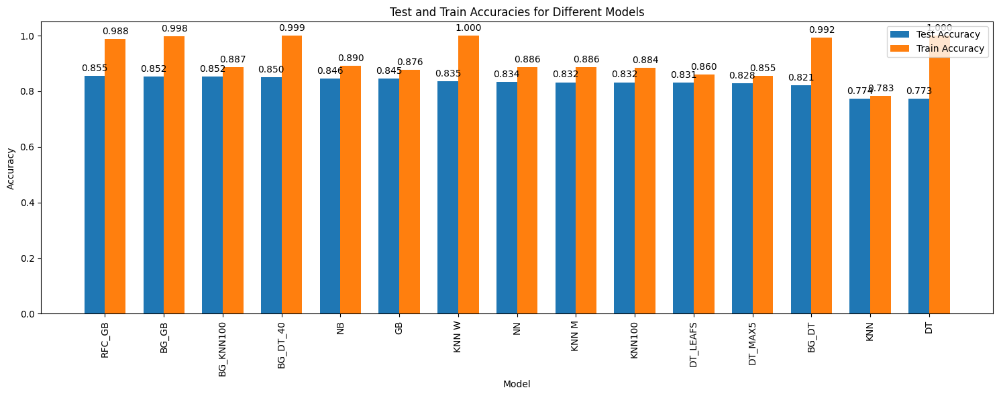

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Sort the Evaluation dataframe by test accuracy
Evaluation_sorted = Evaluation.sort_values('Test Accuracy', ascending=False)

# Set the width of the bars
bar_width = 0.35

# Create the x-axis positions for the bars
x = np.arange(len(Evaluation_sorted))

# Create a bar plot to visualize test and train accuracies
fig, ax = plt.subplots(figsize=(15, 6))
rects1 = ax.bar(x - bar_width/2, Evaluation_sorted['Test Accuracy'], bar_width, label='Test Accuracy')
rects2 = ax.bar(x + bar_width/2, Evaluation_sorted['Train Accuracy'], bar_width, label='Train Accuracy')

# Add labels, title, and legend
ax.set_xlabel('Model')
ax.set_ylabel('Accuracy')
ax.set_title('Test and Train Accuracies for Different Models')
ax.set_xticks(x)
ax.set_xticklabels(Evaluation_sorted['Model'], rotation=90)
ax.legend()

# Add value labels to the bars
def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{:.3f}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

plt.tight_layout()
plt.show()


In [ ]:
top_models = Evaluation.nlargest(3, 'Test Accuracy')
top_model_names = top_models['Model'].tolist()

print("Top 3 models based on test accuracy:")
for model_name in top_model_names:
    print(model_name)


Top 3 models based on test accuracy:
RFC_GB
BG_GB
BG_KNN100


In [ ]:
#Define classification

def print_classification(y_test, y_pred):
    # Classification Report
    print(classification_report(y_test, y_pred))
    
    # Plot
    cm = confusion_matrix(y_test, y_pred)

    plt.figure(figsize = (5,3))
    ax = sns.heatmap(cm, annot=True, fmt='g', cmap = 'Greens')
    ax.set_xlabel('Predicted labels')
    ax.set_ylabel('True labels')
    ax.set_title('Confusion Matrix')
    plt.show()

In [ ]:
modelNN_pred = modelNN.predict(X_test)
gb_predictions = gb_model.predict(combined_test_features)
GB_predictions = model_GB.predict(X_test)
bagging_GD_pred = bagging_GD.predict(X_test)
bagging_KNN100_pred = bagging_KNN100.predict(X_test)

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# create a list of models to compare
models = [(modelNN_pred, modelNN, 'Neural Networks'), (gb_predictions, gb_model, "RFC-Gradient Bosting Ensemble"), (GB_predictions, model_GB, "Gradient Boosting"), (bagging_GD_pred, bagging_GD, "bagging GD"), (bagging_KNN100_pred, bagging_KNN100, "BG_KNN") ]

# create lists to store evaluation scores and metrics
accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
fp_sum_list = []  # List to store the sum of false positives for each model
fn_sum_list = []  # List to store the sum of false negatives for each model

# loop through each model and evaluate its performance
for model_pred, model, model_name in models:
    y_pred = model_pred  # use the provided predictions directly

    # Calculate evaluation metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()

    # Calculate sum of false positives and false negatives
    fp_sum = fp + fn
    fn_sum = fn + fp

    # Store evaluation scores and metrics
    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    fp_sum_list.append(fp_sum)
    fn_sum_list.append(fn_sum)

    # Print evaluation metrics
    print(f"{model_name}:")
    print(f"  Accuracy={accuracy:.3f}, Precision={precision:.3f}, Recall={recall:.3f}, F1={f1:.3f}")
    print(f"  True Positives: {tp}, True Negatives: {tn}, False Positives: {fp}, False Negatives: {fn}")
    print(f"  Sum of Falses: {fp_sum}")
    print()

# Find the best model based on the F1 score
best_model_index = np.argmax(f1_scores)
best_model_pred, best_model, best_model_name = models[best_model_index]
best_f1_score = f1_scores[best_model_index]
best_fp_sum = fp_sum_list[best_model_index]
best_fn_sum = fn_sum_list[best_model_index]


Neural Networks:
  Accuracy=0.845, Precision=0.822, Recall=0.944, F1=0.879
  True Positives: 1524, True Negatives: 765, False Positives: 329, False Negatives: 91
  Sum of Falses: 420

RFC-Gradient Bosting Ensemble:
  Accuracy=0.852, Precision=0.818, Recall=0.967, F1=0.886
  True Positives: 1562, True Negatives: 747, False Positives: 347, False Negatives: 53
  Sum of Falses: 400

Gradient Boosting:
  Accuracy=0.846, Precision=0.815, Recall=0.959, F1=0.881
  True Positives: 1549, True Negatives: 743, False Positives: 351, False Negatives: 66
  Sum of Falses: 417

bagging GD:
  Accuracy=0.852, Precision=0.818, Recall=0.967, F1=0.886
  True Positives: 1562, True Negatives: 746, False Positives: 348, False Negatives: 53
  Sum of Falses: 401

BG_KNN:
  Accuracy=0.834, Precision=0.816, Recall=0.931, F1=0.870
  True Positives: 1503, True Negatives: 756, False Positives: 338, False Negatives: 112
  Sum of Falses: 450



# PREDICT DISC DATASET

In [ ]:
#to use RFC_GB model 

# Generate predictions using the Random Forest model for disc dataset
rf_disc_predictions = rf_model.predict(disc)

# Combine the Random Forest predictions with the original features for disc dataset
combined_final_features = np.column_stack((disc, rf_disc_predictions))


In [ ]:
labels_final = gb_model.predict(combined_final_features)
prediction = pd.DataFrame({'RecordID': test.index,
                     'Outcome': labels_final.astype(int)})

prediction = prediction.set_index("RecordID")
prediction
prediction.to_csv('Group07_version70.csv')